In [ ]:
!git clone https://github.com/Dt-Pham/Advanced-Lane-Lines.git
%cd Advanced-Lane-Lines/

Cloning into 'Advanced-Lane-Lines'...
remote: Enumerating objects: 104, done.
remote: Counting objects: 100% (4/4), done.
remote: Compressing objects: 100% (4/4), done.
remote: Total 104 (delta 3), reused 0 (delta 0), pack-reused 100
Receiving objects: 100% (104/104), 95.77 MiB | 24.19 MiB/s, done.
Resolving deltas: 100% (6/6), done.
/content/Advanced-Lane-Lines


In [ ]:
import numpy as np
import matplotlib.image as mpimg
import cv2
from IPython.display import HTML
from IPython.core.display import Video
from moviepy.editor import VideoFileClip
from CameraCalibration import CameraCalibration
from Thresholding import *
from PerspectiveTransformation import *
from LaneLines import *

class FindLaneLines:
    def __init__(self):
        """ Init Application"""
        self.calibration = CameraCalibration('camera_cal', 9, 6)
        self.thresholding = Thresholding()
        self.transform = PerspectiveTransformation()
        self.lanelines = LaneLines()

    def forward(self, img):
        out_img = np.copy(img)
        img = self.calibration.undistort(img)
        img = self.transform.forward(img)
        img = self.thresholding.forward(img)
        img = self.lanelines.forward(img)
        img = self.transform.backward(img)

        out_img = cv2.addWeighted(out_img, 1, img, 0.6, 0)
        out_img = self.lanelines.plot(out_img)
        return out_img

    def process_image(self, input_path, output_path):
        img = mpimg.imread(input_path)
        out_img = self.forward(img)
        mpimg.imsave(output_path, out_img)

    def process_video(self, input_path, output_path):
        clip = VideoFileClip(input_path)
        out_clip = clip.fl_image(self.forward)
        out_clip.write_videofile(output_path, audio=False)

def main():
    findLaneLines = FindLaneLines()
    findLaneLines.process_video("Input.mp4","output.mp4")

if __name__ == "__main__":
    main()

Moviepy - Building video output.mp4.
Moviepy - Writing video output.mp4



Moviepy - Done !
Moviepy - video ready output.mp4


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = 'Input.mp4'

# Compressed video path
compressed_path = '/content/Advanced-Lane-Lines/output.mp4'

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="6nP7CZeFbwhbNBM3M7CY")
project = rf.workspace("unibo-sgsxs").project("vehicle-detect-from-video")
dataset = project.version(2).download("yolov7")


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.9/69.9 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.5/77.5 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.4 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycler 

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to vehicle-detect-from-video-2 in yolov7pytorch:: 100%|██████████| 534/534 [00:00<00:00, 4287.42it/s]


In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 699.7/699.7 kB 6.4 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO

In [ ]:
model = YOLO("yolov8m.pt")

100%|██████████| 49.7M/49.7M [00:00<00:00, 65.3MB/s]


In [ ]:
results = model.predict("/content/Advanced-Lane-Lines/challenge_video.mp4")



WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/484) /content/Advanced-Lane-Lines/challenge_video.mp4: 384x640 3 cars, 1054.4ms
video 1/1 (2/484) /content/Advanced-Lane-Lines/challenge_video.mp4: 384x640 3 cars, 876.4ms
video 1/1 (3/484) /content/Advanced-Lane-Lines/challenge_video.mp4: 384x640 3 cars, 910.8ms
video 1/1 (4/484) /content/Advanced-Lane-Lines/challenge_video.mp4: 384x640 4 cars, 880.3ms
video 1/1 (5/484) /content/Advanced-Lane-Lines/challenge_video.mp4: 384x640 4 cars, 868

In [ ]:
result = results[0]

In [ ]:
len(result.boxes)

3

In [ ]:
box = result.boxes[0]

In [ ]:
print("Object type:", box.cls)
print("Coordinates:", box.xyxy)
print("Probability:", box.conf)

Object type: tensor([2.])
Coordinates: tensor([[333.3396, 432.1003, 393.6079, 456.1221]])
Probability: tensor([0.7365])


In [ ]:
cords = box.xyxy[0].tolist()
class_id = box.cls[0].item()
conf = box.conf[0].item()
print("Object type:", class_id)
print("Coordinates:", cords)
print("Probability:", conf)

Object type: 2.0
Coordinates: [333.3395690917969, 432.10028076171875, 393.6078796386719, 456.12213134765625]
Probability: 0.7364696264266968


In [ ]:
print(result.names)

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

In [ ]:
cords = box.xyxy[0].tolist()
cords = [round(x) for x in cords]
class_id = result.names[box.cls[0].item()]
conf = round(box.conf[0].item(), 2)
print("Object type:", class_id)
print("Coordinates:", cords)
print("Probability:", conf)

Object type: car
Coordinates: [333, 432, 394, 456]
Probability: 0.74


In [ ]:
for box in result.boxes:
  class_id = result.names[box.cls[0].item()]
  cords = box.xyxy[0].tolist()
  cords = [round(x) for x in cords]
  conf = round(box.conf[0].item(), 2)
  print("Object type:", class_id)
  print("Coordinates:", cords)
  print("Probability:", conf)
  print("---")

Object type: car
Coordinates: [333, 432, 394, 456]
Probability: 0.74
---
Object type: car
Coordinates: [266, 430, 323, 458]
Probability: 0.68
---
Object type: car
Coordinates: [417, 436, 454, 452]
Probability: 0.54
---


In [ ]:
def print_box(box):
    class_id, cords, conf = box
    print("Object type:", class_id)
    print("Coordinates:", cords)
    print("Probability:", conf)
    print("---")

[
    print_box([
        result.names[box.cls[0].item()],
        [round(x) for x in box.xyxy[0].tolist()],
        round(box.conf[0].item(), 2)
    ]) for box in result.boxes
]

Object type: car
Coordinates: [333, 432, 394, 456]
Probability: 0.74
---
Object type: car
Coordinates: [266, 430, 323, 458]
Probability: 0.68
---
Object type: car
Coordinates: [417, 436, 454, 452]
Probability: 0.54
---


[None, None, None]

In [ ]:
result.plot

<bound method Results.plot of ultralytics.engine.results.Results object with attributes:

boxes: ultralytics.engine.results.Boxes object
keypoints: None
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57

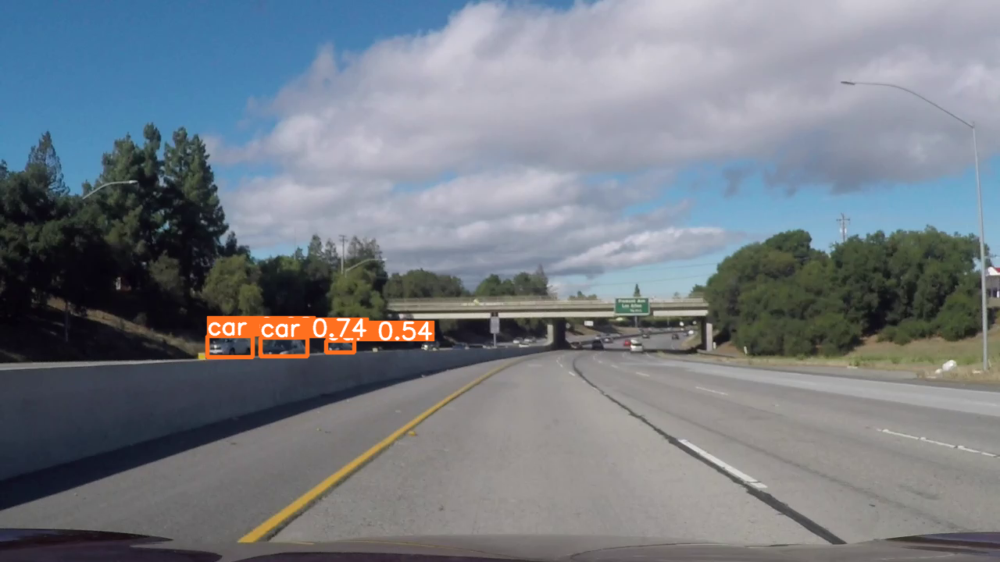

In [ ]:
from PIL import Image
Image.fromarray(result.plot()[:,:,::-1])



In [ ]:
import cv2
from tqdm import tqdm

# Open the video file
cap = cv2.VideoCapture("/content/Advanced-Lane-Lines/challenge_video.mp4")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Define the codec and create a VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*"XVID")
out = cv2.VideoWriter("output_video1.mp4", fourcc, fps, (width, height))

# Process each frame and draw bounding boxes
for frame_idx in tqdm(range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))):
    ret, frame = cap.read()
    if not ret:
        break

    # Use your YOLO model to get predictions for the current frame
    results = model.predict(frame)
    result = results[0]

    # Draw bounding boxes and labels on the frame
    for box in result.boxes:
        class_id = result.names[box.cls[0].item()]
        cords = [round(x) for x in box.xyxy[0].tolist()]
        conf = round(box.conf[0].item(), 2)

        # Draw bounding box
        cv2.rectangle(frame, (cords[0], cords[1]), (cords[2], cords[3]), (0, 255, 0), 2)

        # Draw label
        label = f"{class_id}: {conf}"
        cv2.putText(frame, label, (cords[0], cords[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Write the frame with bounding boxes to the output video
    out.write(frame)

# Release video capture and writer objects
cap.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


  0%|          | 0/484 [00:00<?, ?it/s]


0: 384x640 3 cars, 1271.4ms
Speed: 8.3ms preprocess, 1271.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  0%|          | 1/484 [00:01<10:51,  1.35s/it]


0: 384x640 3 cars, 995.0ms
Speed: 2.5ms preprocess, 995.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  0%|          | 2/484 [00:02<09:20,  1.16s/it]


0: 384x640 3 cars, 1389.4ms
Speed: 3.5ms preprocess, 1389.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 3/484 [00:03<10:16,  1.28s/it]


0: 384x640 4 cars, 887.5ms
Speed: 2.5ms preprocess, 887.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 4/484 [00:04<09:06,  1.14s/it]


0: 384x640 4 cars, 1086.5ms
Speed: 2.5ms preprocess, 1086.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 5/484 [00:05<09:04,  1.14s/it]


0: 384x640 3 cars, 1375.8ms
Speed: 2.5ms preprocess, 1375.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 6/484 [00:07<09:48,  1.23s/it]


0: 384x640 6 cars, 1628.2ms
Speed: 2.5ms preprocess, 1628.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  1%|▏         | 7/484 [00:08<10:56,  1.38s/it]


0: 384x640 4 cars, 1464.1ms
Speed: 2.6ms preprocess, 1464.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 8/484 [00:10<11:13,  1.41s/it]


0: 384x640 3 cars, 902.6ms
Speed: 2.5ms preprocess, 902.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 9/484 [00:11<10:00,  1.26s/it]


0: 384x640 4 cars, 1509.9ms
Speed: 5.5ms preprocess, 1509.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 10/484 [00:12<10:45,  1.36s/it]


0: 384x640 5 cars, 1778.7ms
Speed: 2.5ms preprocess, 1778.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 11/484 [00:14<11:52,  1.51s/it]


0: 384x640 4 cars, 1854.8ms
Speed: 9.8ms preprocess, 1854.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 12/484 [00:16<12:50,  1.63s/it]


0: 384x640 6 cars, 1992.7ms
Speed: 2.6ms preprocess, 1992.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 13/484 [00:18<13:50,  1.76s/it]


0: 384x640 6 cars, 2432.2ms
Speed: 2.6ms preprocess, 2432.2ms inference, 7.4ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 14/484 [00:21<15:38,  2.00s/it]


0: 384x640 4 cars, 3344.1ms
Speed: 3.3ms preprocess, 3344.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 15/484 [00:24<19:00,  2.43s/it]


0: 384x640 6 cars, 1925.7ms
Speed: 5.6ms preprocess, 1925.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 16/484 [00:26<18:01,  2.31s/it]


0: 384x640 3 cars, 1732.6ms
Speed: 2.9ms preprocess, 1732.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  4%|▎         | 17/484 [00:28<16:46,  2.15s/it]


0: 384x640 4 cars, 1716.5ms
Speed: 3.3ms preprocess, 1716.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  4%|▎         | 18/484 [00:30<15:50,  2.04s/it]


0: 384x640 3 cars, 2012.5ms
Speed: 7.2ms preprocess, 2012.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 19/484 [00:32<15:52,  2.05s/it]


0: 384x640 3 cars, 896.2ms
Speed: 2.5ms preprocess, 896.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 20/484 [00:33<13:14,  1.71s/it]


0: 384x640 4 cars, 1099.7ms
Speed: 2.5ms preprocess, 1099.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 21/484 [00:34<11:52,  1.54s/it]


0: 384x640 2 cars, 1428.0ms
Speed: 2.6ms preprocess, 1428.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 22/484 [00:35<11:42,  1.52s/it]


0: 384x640 3 cars, 1366.9ms
Speed: 2.4ms preprocess, 1366.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 23/484 [00:37<11:24,  1.49s/it]


0: 384x640 3 cars, 1260.7ms
Speed: 2.5ms preprocess, 1260.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 24/484 [00:38<10:57,  1.43s/it]


0: 384x640 3 cars, 887.4ms
Speed: 2.5ms preprocess, 887.4ms inference, 3.0ms postprocess per image at shape (1, 3, 384, 640)


  5%|▌         | 25/484 [00:39<09:47,  1.28s/it]


0: 384x640 2 cars, 895.2ms
Speed: 2.6ms preprocess, 895.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  5%|▌         | 26/484 [00:40<08:57,  1.17s/it]


0: 384x640 2 cars, 892.8ms
Speed: 3.4ms preprocess, 892.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 27/484 [00:41<08:22,  1.10s/it]


0: 384x640 2 cars, 878.6ms
Speed: 2.4ms preprocess, 878.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 28/484 [00:42<07:56,  1.05s/it]


0: 384x640 3 cars, 879.6ms
Speed: 2.7ms preprocess, 879.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 29/484 [00:43<07:38,  1.01s/it]


0: 384x640 2 cars, 887.8ms
Speed: 2.5ms preprocess, 887.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 30/484 [00:44<07:25,  1.02it/s]


0: 384x640 2 cars, 886.3ms
Speed: 2.5ms preprocess, 886.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▋         | 31/484 [00:45<07:15,  1.04it/s]


0: 384x640 2 cars, 886.9ms
Speed: 2.5ms preprocess, 886.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 32/484 [00:46<07:10,  1.05it/s]


0: 384x640 2 cars, 892.9ms
Speed: 2.5ms preprocess, 892.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 33/484 [00:46<07:05,  1.06it/s]


0: 384x640 3 cars, 893.1ms
Speed: 2.7ms preprocess, 893.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 34/484 [00:47<07:02,  1.07it/s]


0: 384x640 3 cars, 1101.9ms
Speed: 2.5ms preprocess, 1101.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 35/484 [00:49<07:27,  1.00it/s]


0: 384x640 3 cars, 1366.9ms
Speed: 2.6ms preprocess, 1366.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 36/484 [00:50<08:21,  1.12s/it]


0: 384x640 3 cars, 1360.6ms
Speed: 2.5ms preprocess, 1360.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 37/484 [00:51<08:59,  1.21s/it]


0: 384x640 4 cars, 1070.1ms
Speed: 2.4ms preprocess, 1070.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 38/484 [00:52<08:45,  1.18s/it]


0: 384x640 4 cars, 885.8ms
Speed: 2.4ms preprocess, 885.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 39/484 [00:53<08:10,  1.10s/it]


0: 384x640 4 cars, 877.6ms
Speed: 2.6ms preprocess, 877.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 40/484 [00:54<07:43,  1.04s/it]


0: 384x640 5 cars, 881.6ms
Speed: 2.7ms preprocess, 881.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 41/484 [00:55<07:24,  1.00s/it]


0: 384x640 6 cars, 890.9ms
Speed: 2.7ms preprocess, 890.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  9%|▊         | 42/484 [00:56<07:13,  1.02it/s]


0: 384x640 5 cars, 892.4ms
Speed: 2.4ms preprocess, 892.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 43/484 [00:57<07:04,  1.04it/s]


0: 384x640 4 cars, 888.1ms
Speed: 2.4ms preprocess, 888.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 44/484 [00:58<06:57,  1.05it/s]


0: 384x640 5 cars, 885.1ms
Speed: 3.5ms preprocess, 885.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 45/484 [00:59<06:52,  1.06it/s]


0: 384x640 4 cars, 897.1ms
Speed: 2.8ms preprocess, 897.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 46/484 [01:00<06:50,  1.07it/s]


0: 384x640 4 cars, 933.7ms
Speed: 2.4ms preprocess, 933.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 47/484 [01:01<06:54,  1.06it/s]


0: 384x640 8 cars, 881.7ms
Speed: 2.4ms preprocess, 881.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 48/484 [01:02<06:49,  1.06it/s]


0: 384x640 6 cars, 1326.0ms
Speed: 2.5ms preprocess, 1326.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 10%|█         | 49/484 [01:03<07:44,  1.07s/it]


0: 384x640 6 cars, 1355.2ms
Speed: 2.4ms preprocess, 1355.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 10%|█         | 50/484 [01:04<08:26,  1.17s/it]


0: 384x640 6 cars, 1314.6ms
Speed: 2.4ms preprocess, 1314.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 51/484 [01:06<08:48,  1.22s/it]


0: 384x640 6 cars, 881.5ms
Speed: 2.5ms preprocess, 881.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 52/484 [01:07<08:07,  1.13s/it]


0: 384x640 5 cars, 875.7ms
Speed: 2.4ms preprocess, 875.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 53/484 [01:08<07:37,  1.06s/it]


0: 384x640 4 cars, 887.6ms
Speed: 2.5ms preprocess, 887.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 54/484 [01:09<07:17,  1.02s/it]


0: 384x640 6 cars, 885.6ms
Speed: 2.3ms preprocess, 885.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 11%|█▏        | 55/484 [01:09<07:04,  1.01it/s]


0: 384x640 7 cars, 890.7ms
Speed: 2.5ms preprocess, 890.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 56/484 [01:10<06:54,  1.03it/s]


0: 384x640 6 cars, 886.8ms
Speed: 2.5ms preprocess, 886.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 57/484 [01:11<06:47,  1.05it/s]


0: 384x640 5 cars, 891.4ms
Speed: 2.6ms preprocess, 891.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 58/484 [01:12<06:42,  1.06it/s]


0: 384x640 4 cars, 883.4ms
Speed: 2.9ms preprocess, 883.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 59/484 [01:13<06:38,  1.07it/s]


0: 384x640 4 cars, 891.3ms
Speed: 2.5ms preprocess, 891.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 60/484 [01:14<06:36,  1.07it/s]


0: 384x640 6 cars, 876.4ms
Speed: 2.4ms preprocess, 876.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 61/484 [01:15<06:31,  1.08it/s]


0: 384x640 5 cars, 1031.2ms
Speed: 2.5ms preprocess, 1031.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 62/484 [01:16<06:50,  1.03it/s]


0: 384x640 6 cars, 1373.5ms
Speed: 2.4ms preprocess, 1373.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 63/484 [01:17<07:45,  1.11s/it]


0: 384x640 6 cars, 1361.6ms
Speed: 2.4ms preprocess, 1361.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 64/484 [01:19<08:22,  1.20s/it]


0: 384x640 6 cars, 1100.1ms
Speed: 2.7ms preprocess, 1100.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 65/484 [01:20<08:13,  1.18s/it]


0: 384x640 5 cars, 891.1ms
Speed: 3.4ms preprocess, 891.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▎        | 66/484 [01:21<07:41,  1.10s/it]


0: 384x640 6 cars, 899.7ms
Speed: 3.0ms preprocess, 899.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 67/484 [01:22<07:18,  1.05s/it]


0: 384x640 5 cars, 900.6ms
Speed: 2.5ms preprocess, 900.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 68/484 [01:23<07:02,  1.02s/it]


0: 384x640 6 cars, 888.7ms
Speed: 4.8ms preprocess, 888.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 69/484 [01:24<06:50,  1.01it/s]


0: 384x640 7 cars, 897.8ms
Speed: 2.5ms preprocess, 897.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 70/484 [01:25<06:42,  1.03it/s]


0: 384x640 5 cars, 891.7ms
Speed: 2.5ms preprocess, 891.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▍        | 71/484 [01:26<06:35,  1.04it/s]


0: 384x640 6 cars, 895.9ms
Speed: 2.6ms preprocess, 895.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▍        | 72/484 [01:27<06:31,  1.05it/s]


0: 384x640 5 cars, 884.5ms
Speed: 2.5ms preprocess, 884.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 73/484 [01:27<06:26,  1.06it/s]


0: 384x640 5 cars, 899.8ms
Speed: 2.6ms preprocess, 899.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 74/484 [01:28<06:24,  1.07it/s]


0: 384x640 6 cars, 887.3ms
Speed: 2.5ms preprocess, 887.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 75/484 [01:29<06:20,  1.07it/s]


0: 384x640 7 cars, 1269.8ms
Speed: 2.5ms preprocess, 1269.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 76/484 [01:31<07:06,  1.05s/it]


0: 384x640 8 cars, 1359.3ms
Speed: 5.5ms preprocess, 1359.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 77/484 [01:32<07:50,  1.16s/it]


0: 384x640 7 cars, 1355.8ms
Speed: 2.5ms preprocess, 1355.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 78/484 [01:33<08:17,  1.23s/it]


0: 384x640 7 cars, 892.1ms
Speed: 3.2ms preprocess, 892.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▋        | 79/484 [01:34<07:40,  1.14s/it]


0: 384x640 8 cars, 894.2ms
Speed: 2.4ms preprocess, 894.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 80/484 [01:35<07:14,  1.08s/it]


0: 384x640 8 cars, 891.6ms
Speed: 3.6ms preprocess, 891.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 81/484 [01:36<06:56,  1.03s/it]


0: 384x640 10 cars, 887.0ms
Speed: 3.0ms preprocess, 887.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 82/484 [01:37<06:42,  1.00s/it]


0: 384x640 9 cars, 884.7ms
Speed: 2.5ms preprocess, 884.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 83/484 [01:38<06:32,  1.02it/s]


0: 384x640 7 cars, 878.7ms
Speed: 3.4ms preprocess, 878.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 84/484 [01:39<06:23,  1.04it/s]


0: 384x640 6 cars, 877.8ms
Speed: 2.9ms preprocess, 877.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 85/484 [01:40<06:17,  1.06it/s]


0: 384x640 7 cars, 887.3ms
Speed: 2.5ms preprocess, 887.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 86/484 [01:41<06:13,  1.07it/s]


0: 384x640 6 cars, 887.3ms
Speed: 2.5ms preprocess, 887.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 87/484 [01:42<06:10,  1.07it/s]


0: 384x640 5 cars, 881.9ms
Speed: 2.5ms preprocess, 881.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 88/484 [01:43<06:07,  1.08it/s]


0: 384x640 5 cars, 983.4ms
Speed: 2.5ms preprocess, 983.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 89/484 [01:44<06:19,  1.04it/s]


0: 384x640 5 cars, 1365.3ms
Speed: 2.5ms preprocess, 1365.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▊        | 90/484 [01:45<07:13,  1.10s/it]


0: 384x640 5 cars, 1382.9ms
Speed: 2.5ms preprocess, 1382.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 91/484 [01:47<07:50,  1.20s/it]


0: 384x640 4 cars, 1113.4ms
Speed: 2.4ms preprocess, 1113.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 92/484 [01:48<07:43,  1.18s/it]


0: 384x640 4 cars, 884.3ms
Speed: 5.1ms preprocess, 884.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 93/484 [01:49<07:12,  1.11s/it]


0: 384x640 5 cars, 882.6ms
Speed: 2.6ms preprocess, 882.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 94/484 [01:50<06:48,  1.05s/it]


0: 384x640 5 cars, 875.6ms
Speed: 2.6ms preprocess, 875.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 20%|█▉        | 95/484 [01:50<06:33,  1.01s/it]


0: 384x640 6 cars, 882.8ms
Speed: 4.5ms preprocess, 882.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 20%|█▉        | 96/484 [01:51<06:21,  1.02it/s]


0: 384x640 6 cars, 899.2ms
Speed: 2.6ms preprocess, 899.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 97/484 [01:52<06:15,  1.03it/s]


0: 384x640 6 cars, 896.8ms
Speed: 2.5ms preprocess, 896.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 98/484 [01:53<06:09,  1.04it/s]


0: 384x640 6 cars, 890.8ms
Speed: 2.5ms preprocess, 890.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 99/484 [01:54<06:05,  1.05it/s]


0: 384x640 5 cars, 892.2ms
Speed: 2.5ms preprocess, 892.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 100/484 [01:55<06:02,  1.06it/s]


0: 384x640 5 cars, 883.1ms
Speed: 2.7ms preprocess, 883.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 101/484 [01:56<05:58,  1.07it/s]


0: 384x640 4 cars, 897.1ms
Speed: 2.6ms preprocess, 897.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 102/484 [01:57<05:56,  1.07it/s]


0: 384x640 6 cars, 1251.8ms
Speed: 2.5ms preprocess, 1251.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 21%|██▏       | 103/484 [01:58<06:35,  1.04s/it]


0: 384x640 6 cars, 1369.5ms
Speed: 2.6ms preprocess, 1369.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 21%|██▏       | 104/484 [02:00<07:17,  1.15s/it]


0: 384x640 5 cars, 1529.3ms
Speed: 5.7ms preprocess, 1529.3ms inference, 11.6ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 105/484 [02:01<08:09,  1.29s/it]


0: 384x640 5 cars, 1161.8ms
Speed: 2.5ms preprocess, 1161.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 106/484 [02:02<07:59,  1.27s/it]


0: 384x640 5 cars, 883.2ms
Speed: 2.5ms preprocess, 883.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 107/484 [02:03<07:18,  1.16s/it]


0: 384x640 5 cars, 886.7ms
Speed: 3.4ms preprocess, 886.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 108/484 [02:04<06:49,  1.09s/it]


0: 384x640 5 cars, 905.3ms
Speed: 4.2ms preprocess, 905.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 109/484 [02:05<06:31,  1.05s/it]


0: 384x640 5 cars, 891.0ms
Speed: 2.4ms preprocess, 891.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 110/484 [02:06<06:17,  1.01s/it]


0: 384x640 5 cars, 893.0ms
Speed: 2.5ms preprocess, 893.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 111/484 [02:07<06:06,  1.02it/s]


0: 384x640 5 cars, 874.1ms
Speed: 2.5ms preprocess, 874.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 112/484 [02:08<05:57,  1.04it/s]


0: 384x640 5 cars, 885.0ms
Speed: 2.7ms preprocess, 885.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 113/484 [02:09<05:51,  1.06it/s]


0: 384x640 4 cars, 883.2ms
Speed: 2.6ms preprocess, 883.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▎       | 114/484 [02:10<05:47,  1.06it/s]


0: 384x640 4 cars, 1338.6ms
Speed: 3.1ms preprocess, 1338.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 115/484 [02:11<06:35,  1.07s/it]


0: 384x640 3 cars, 2027.5ms
Speed: 5.1ms preprocess, 2027.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 116/484 [02:13<08:25,  1.37s/it]


0: 384x640 4 cars, 1353.9ms
Speed: 2.6ms preprocess, 1353.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 117/484 [02:15<08:27,  1.38s/it]


0: 384x640 4 cars, 1011.5ms
Speed: 2.6ms preprocess, 1011.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 118/484 [02:16<07:48,  1.28s/it]


0: 384x640 3 cars, 888.7ms
Speed: 2.8ms preprocess, 888.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▍       | 119/484 [02:17<07:08,  1.17s/it]


0: 384x640 4 cars, 886.4ms
Speed: 2.4ms preprocess, 886.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▍       | 120/484 [02:18<06:39,  1.10s/it]


0: 384x640 3 cars, 880.6ms
Speed: 2.5ms preprocess, 880.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 121/484 [02:19<06:20,  1.05s/it]


0: 384x640 2 cars, 866.4ms
Speed: 4.8ms preprocess, 866.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 122/484 [02:19<06:03,  1.00s/it]


0: 384x640 2 cars, 890.4ms
Speed: 2.5ms preprocess, 890.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 123/484 [02:20<05:53,  1.02it/s]


0: 384x640 2 cars, 889.8ms
Speed: 3.1ms preprocess, 889.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 124/484 [02:21<05:46,  1.04it/s]


0: 384x640 2 cars, 891.3ms
Speed: 2.4ms preprocess, 891.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 125/484 [02:22<05:41,  1.05it/s]


0: 384x640 2 cars, 886.7ms
Speed: 4.5ms preprocess, 886.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 126/484 [02:23<05:37,  1.06it/s]


0: 384x640 2 cars, 894.0ms
Speed: 2.6ms preprocess, 894.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 127/484 [02:24<05:35,  1.06it/s]


0: 384x640 2 cars, 890.3ms
Speed: 3.7ms preprocess, 890.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▋       | 128/484 [02:25<05:33,  1.07it/s]


0: 384x640 2 cars, 1342.5ms
Speed: 3.9ms preprocess, 1342.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 129/484 [02:26<06:20,  1.07s/it]


0: 384x640 2 cars, 1370.4ms
Speed: 2.9ms preprocess, 1370.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 130/484 [02:28<06:54,  1.17s/it]


0: 384x640 2 cars, 1284.7ms
Speed: 2.3ms preprocess, 1284.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 131/484 [02:29<07:09,  1.22s/it]


0: 384x640 2 cars, 890.1ms
Speed: 2.5ms preprocess, 890.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 132/484 [02:30<06:36,  1.13s/it]


0: 384x640 4 cars, 871.3ms
Speed: 4.6ms preprocess, 871.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 133/484 [02:31<06:12,  1.06s/it]


0: 384x640 4 cars, 888.0ms
Speed: 2.5ms preprocess, 888.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 134/484 [02:32<05:57,  1.02s/it]


0: 384x640 5 cars, 880.0ms
Speed: 2.4ms preprocess, 880.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 135/484 [02:33<05:45,  1.01it/s]


0: 384x640 4 cars, 882.7ms
Speed: 2.5ms preprocess, 882.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 136/484 [02:34<05:36,  1.03it/s]


0: 384x640 4 cars, 887.9ms
Speed: 3.2ms preprocess, 887.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 137/484 [02:35<05:31,  1.05it/s]


0: 384x640 5 cars, 896.8ms
Speed: 3.3ms preprocess, 896.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▊       | 138/484 [02:36<05:28,  1.05it/s]


0: 384x640 7 cars, 894.0ms
Speed: 2.4ms preprocess, 894.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▊       | 139/484 [02:36<05:25,  1.06it/s]


0: 384x640 7 cars, 890.4ms
Speed: 3.5ms preprocess, 890.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 140/484 [02:37<05:22,  1.07it/s]


0: 384x640 6 cars, 885.7ms
Speed: 2.5ms preprocess, 885.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 141/484 [02:38<05:19,  1.07it/s]


0: 384x640 6 cars, 1058.8ms
Speed: 2.5ms preprocess, 1058.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 142/484 [02:39<05:37,  1.01it/s]


0: 384x640 7 cars, 1369.5ms
Speed: 2.6ms preprocess, 1369.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 143/484 [02:41<06:20,  1.12s/it]


0: 384x640 5 cars, 1364.3ms
Speed: 2.4ms preprocess, 1364.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 144/484 [02:42<06:49,  1.20s/it]


0: 384x640 7 cars, 1076.3ms
Speed: 2.5ms preprocess, 1076.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 145/484 [02:43<06:39,  1.18s/it]


0: 384x640 6 cars, 900.8ms
Speed: 2.5ms preprocess, 900.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 30%|███       | 146/484 [02:44<06:13,  1.11s/it]


0: 384x640 5 cars, 891.4ms
Speed: 6.6ms preprocess, 891.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 30%|███       | 147/484 [02:45<05:55,  1.05s/it]


0: 384x640 4 cars, 884.9ms
Speed: 3.3ms preprocess, 884.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 148/484 [02:46<05:40,  1.01s/it]


0: 384x640 4 cars, 897.4ms
Speed: 2.9ms preprocess, 897.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 149/484 [02:47<05:31,  1.01it/s]


0: 384x640 4 cars, 888.5ms
Speed: 2.4ms preprocess, 888.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 150/484 [02:48<05:24,  1.03it/s]


0: 384x640 6 cars, 882.1ms
Speed: 2.8ms preprocess, 882.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 151/484 [02:49<05:18,  1.05it/s]


0: 384x640 5 cars, 876.4ms
Speed: 2.5ms preprocess, 876.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███▏      | 152/484 [02:50<05:13,  1.06it/s]


0: 384x640 5 cars, 886.9ms
Speed: 2.5ms preprocess, 886.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 153/484 [02:51<05:10,  1.07it/s]


0: 384x640 5 cars, 897.8ms
Speed: 3.6ms preprocess, 897.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 154/484 [02:52<05:09,  1.07it/s]


0: 384x640 5 cars, 885.4ms
Speed: 3.1ms preprocess, 885.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 155/484 [02:53<05:07,  1.07it/s]


0: 384x640 5 cars, 1352.1ms
Speed: 2.6ms preprocess, 1352.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 156/484 [02:54<05:52,  1.07s/it]


0: 384x640 3 cars, 1373.1ms
Speed: 2.5ms preprocess, 1373.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 157/484 [02:55<06:25,  1.18s/it]


0: 384x640 3 cars, 1256.3ms
Speed: 2.5ms preprocess, 1256.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 158/484 [02:57<06:35,  1.21s/it]


0: 384x640 3 cars, 885.6ms
Speed: 3.9ms preprocess, 885.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 159/484 [02:58<06:06,  1.13s/it]


0: 384x640 4 cars, 882.0ms
Speed: 3.2ms preprocess, 882.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 160/484 [02:59<05:45,  1.07s/it]


0: 384x640 4 cars, 892.0ms
Speed: 2.5ms preprocess, 892.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 161/484 [03:00<05:30,  1.02s/it]


0: 384x640 4 cars, 880.1ms
Speed: 2.3ms preprocess, 880.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 162/484 [03:00<05:19,  1.01it/s]


0: 384x640 5 cars, 892.3ms
Speed: 2.6ms preprocess, 892.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▎      | 163/484 [03:01<05:12,  1.03it/s]


0: 384x640 4 cars, 938.1ms
Speed: 2.5ms preprocess, 938.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 164/484 [03:02<05:12,  1.03it/s]


0: 384x640 4 cars, 883.7ms
Speed: 2.4ms preprocess, 883.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 165/484 [03:03<05:05,  1.04it/s]


0: 384x640 4 cars, 887.1ms
Speed: 2.4ms preprocess, 887.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 166/484 [03:04<05:01,  1.06it/s]


0: 384x640 4 cars, 874.7ms
Speed: 2.5ms preprocess, 874.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 167/484 [03:05<04:56,  1.07it/s]


0: 384x640 4 cars, 917.8ms
Speed: 2.4ms preprocess, 917.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 168/484 [03:06<04:57,  1.06it/s]


0: 384x640 5 cars, 1129.6ms
Speed: 2.9ms preprocess, 1129.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 169/484 [03:07<05:18,  1.01s/it]


0: 384x640 4 cars, 1370.6ms
Speed: 2.5ms preprocess, 1370.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▌      | 170/484 [03:09<05:56,  1.13s/it]


0: 384x640 4 cars, 1362.8ms
Speed: 2.6ms preprocess, 1362.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▌      | 171/484 [03:10<06:20,  1.22s/it]


0: 384x640 5 cars, 998.0ms
Speed: 2.5ms preprocess, 998.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 172/484 [03:11<06:02,  1.16s/it]


0: 384x640 5 cars, 883.6ms
Speed: 2.4ms preprocess, 883.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 173/484 [03:12<05:39,  1.09s/it]


0: 384x640 6 cars, 883.8ms
Speed: 4.2ms preprocess, 883.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 174/484 [03:13<05:22,  1.04s/it]


0: 384x640 6 cars, 894.1ms
Speed: 2.5ms preprocess, 894.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 175/484 [03:14<05:10,  1.01s/it]


0: 384x640 7 cars, 894.1ms
Speed: 2.7ms preprocess, 894.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▋      | 176/484 [03:15<05:03,  1.02it/s]


0: 384x640 7 cars, 899.1ms
Speed: 2.5ms preprocess, 899.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 177/484 [03:16<04:57,  1.03it/s]


0: 384x640 6 cars, 886.8ms
Speed: 2.6ms preprocess, 886.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 178/484 [03:17<04:52,  1.04it/s]


0: 384x640 6 cars, 875.6ms
Speed: 2.8ms preprocess, 875.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 179/484 [03:18<04:47,  1.06it/s]


0: 384x640 6 cars, 902.9ms
Speed: 2.5ms preprocess, 902.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 180/484 [03:19<04:45,  1.06it/s]


0: 384x640 6 cars, 897.0ms
Speed: 2.8ms preprocess, 897.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 181/484 [03:19<04:44,  1.07it/s]


0: 384x640 6 cars, 889.1ms
Speed: 2.7ms preprocess, 889.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 182/484 [03:20<04:41,  1.07it/s]


0: 384x640 6 cars, 1372.4ms
Speed: 2.5ms preprocess, 1372.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 183/484 [03:22<05:24,  1.08s/it]


0: 384x640 6 cars, 1376.3ms
Speed: 2.4ms preprocess, 1376.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 184/484 [03:23<05:53,  1.18s/it]


0: 384x640 5 cars, 1250.7ms
Speed: 2.6ms preprocess, 1250.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 185/484 [03:25<06:02,  1.21s/it]


0: 384x640 5 cars, 888.3ms
Speed: 2.5ms preprocess, 888.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 186/484 [03:25<05:35,  1.13s/it]


0: 384x640 6 cars, 893.6ms
Speed: 2.6ms preprocess, 893.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▊      | 187/484 [03:26<05:17,  1.07s/it]


0: 384x640 4 cars, 896.8ms
Speed: 2.4ms preprocess, 896.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 188/484 [03:27<05:04,  1.03s/it]


0: 384x640 5 cars, 885.2ms
Speed: 2.5ms preprocess, 885.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 189/484 [03:28<04:53,  1.00it/s]


0: 384x640 5 cars, 871.4ms
Speed: 5.4ms preprocess, 871.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 190/484 [03:29<04:45,  1.03it/s]


0: 384x640 5 cars, 890.9ms
Speed: 2.5ms preprocess, 890.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 191/484 [03:30<04:40,  1.04it/s]


0: 384x640 5 cars, 884.2ms
Speed: 2.6ms preprocess, 884.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 40%|███▉      | 192/484 [03:31<04:36,  1.06it/s]


0: 384x640 5 cars, 902.1ms
Speed: 2.5ms preprocess, 902.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 40%|███▉      | 193/484 [03:32<04:34,  1.06it/s]


0: 384x640 5 cars, 894.5ms
Speed: 3.0ms preprocess, 894.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 194/484 [03:33<04:32,  1.06it/s]


0: 384x640 5 cars, 894.4ms
Speed: 2.8ms preprocess, 894.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 195/484 [03:34<04:30,  1.07it/s]


0: 384x640 6 cars, 1118.6ms
Speed: 2.9ms preprocess, 1118.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 196/484 [03:35<04:48,  1.00s/it]


0: 384x640 5 cars, 1389.0ms
Speed: 2.5ms preprocess, 1389.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 197/484 [03:36<05:24,  1.13s/it]


0: 384x640 5 cars, 1374.7ms
Speed: 2.4ms preprocess, 1374.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 198/484 [03:38<05:48,  1.22s/it]


0: 384x640 5 cars, 1032.6ms
Speed: 2.5ms preprocess, 1032.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 199/484 [03:39<05:34,  1.17s/it]


0: 384x640 4 cars, 896.7ms
Speed: 2.3ms preprocess, 896.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 41%|████▏     | 200/484 [03:40<05:12,  1.10s/it]


0: 384x640 4 cars, 1 stop sign, 902.9ms
Speed: 2.5ms preprocess, 902.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 201/484 [03:41<04:57,  1.05s/it]


0: 384x640 4 cars, 879.5ms
Speed: 2.6ms preprocess, 879.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 202/484 [03:42<04:44,  1.01s/it]


0: 384x640 2 cars, 1 stop sign, 892.2ms
Speed: 2.5ms preprocess, 892.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 203/484 [03:43<04:37,  1.01it/s]


0: 384x640 3 cars, 898.6ms
Speed: 2.6ms preprocess, 898.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 204/484 [03:44<04:31,  1.03it/s]


0: 384x640 5 cars, 1 stop sign, 898.1ms
Speed: 3.5ms preprocess, 898.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 205/484 [03:44<04:27,  1.04it/s]


0: 384x640 4 cars, 1 stop sign, 905.3ms
Speed: 3.5ms preprocess, 905.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 206/484 [03:45<04:24,  1.05it/s]


0: 384x640 4 cars, 903.2ms
Speed: 2.6ms preprocess, 903.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 207/484 [03:46<04:22,  1.06it/s]


0: 384x640 3 cars, 1 stop sign, 901.1ms
Speed: 2.6ms preprocess, 901.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 208/484 [03:47<04:20,  1.06it/s]


0: 384x640 2 cars, 902.5ms
Speed: 2.7ms preprocess, 902.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 209/484 [03:48<04:19,  1.06it/s]


0: 384x640 2 cars, 1 stop sign, 1381.9ms
Speed: 2.5ms preprocess, 1381.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 210/484 [03:50<04:58,  1.09s/it]


0: 384x640 2 cars, 1 stop sign, 1371.0ms
Speed: 2.8ms preprocess, 1371.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▎     | 211/484 [03:51<05:24,  1.19s/it]


0: 384x640 3 cars, 1 stop sign, 1244.5ms
Speed: 2.4ms preprocess, 1244.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 212/484 [03:52<05:31,  1.22s/it]


0: 384x640 3 cars, 900.1ms
Speed: 2.9ms preprocess, 900.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 213/484 [03:53<05:07,  1.14s/it]


0: 384x640 3 cars, 892.2ms
Speed: 3.2ms preprocess, 892.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 214/484 [03:54<04:49,  1.07s/it]


0: 384x640 4 cars, 1 stop sign, 876.0ms
Speed: 2.5ms preprocess, 876.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 215/484 [03:55<04:35,  1.02s/it]


0: 384x640 3 cars, 1 stop sign, 881.4ms
Speed: 3.5ms preprocess, 881.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 216/484 [03:56<04:25,  1.01it/s]


0: 384x640 4 cars, 1 stop sign, 893.1ms
Speed: 2.6ms preprocess, 893.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 217/484 [03:57<04:19,  1.03it/s]


0: 384x640 4 cars, 1 stop sign, 896.3ms
Speed: 2.4ms preprocess, 896.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 218/484 [03:58<04:15,  1.04it/s]


0: 384x640 4 cars, 896.2ms
Speed: 2.8ms preprocess, 896.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 219/484 [03:59<04:12,  1.05it/s]


0: 384x640 4 cars, 887.9ms
Speed: 2.5ms preprocess, 887.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 220/484 [04:00<04:09,  1.06it/s]


0: 384x640 4 cars, 1 stop sign, 893.1ms
Speed: 2.6ms preprocess, 893.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 221/484 [04:01<04:07,  1.06it/s]


0: 384x640 2 cars, 1 stop sign, 893.2ms
Speed: 3.0ms preprocess, 893.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 222/484 [04:02<04:05,  1.07it/s]


0: 384x640 2 cars, 1 stop sign, 1246.8ms
Speed: 2.9ms preprocess, 1246.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 223/484 [04:03<04:32,  1.04s/it]


0: 384x640 3 cars, 1 stop sign, 1373.0ms
Speed: 2.4ms preprocess, 1373.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▋     | 224/484 [04:04<04:59,  1.15s/it]


0: 384x640 5 cars, 1 stop sign, 1364.0ms
Speed: 2.9ms preprocess, 1364.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▋     | 225/484 [04:06<05:18,  1.23s/it]


0: 384x640 5 cars, 1 stop sign, 982.1ms
Speed: 2.5ms preprocess, 982.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 226/484 [04:07<05:00,  1.16s/it]


0: 384x640 4 cars, 1 stop sign, 881.6ms
Speed: 2.4ms preprocess, 881.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 227/484 [04:08<04:40,  1.09s/it]


0: 384x640 5 cars, 892.8ms
Speed: 3.6ms preprocess, 892.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 228/484 [04:09<04:26,  1.04s/it]


0: 384x640 4 cars, 882.6ms
Speed: 2.5ms preprocess, 882.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 229/484 [04:09<04:16,  1.01s/it]


0: 384x640 5 cars, 893.9ms
Speed: 4.1ms preprocess, 893.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 230/484 [04:10<04:09,  1.02it/s]


0: 384x640 1 person, 6 cars, 891.8ms
Speed: 2.9ms preprocess, 891.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 231/484 [04:11<04:04,  1.03it/s]


0: 384x640 5 cars, 890.7ms
Speed: 2.5ms preprocess, 890.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 232/484 [04:12<04:00,  1.05it/s]


0: 384x640 5 cars, 888.3ms
Speed: 2.5ms preprocess, 888.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 233/484 [04:13<03:57,  1.06it/s]


0: 384x640 5 cars, 900.6ms
Speed: 2.6ms preprocess, 900.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 234/484 [04:14<03:55,  1.06it/s]


0: 384x640 5 cars, 885.2ms
Speed: 3.2ms preprocess, 885.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▊     | 235/484 [04:15<03:53,  1.07it/s]


0: 384x640 5 cars, 909.7ms
Speed: 2.7ms preprocess, 909.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 236/484 [04:16<03:53,  1.06it/s]


0: 384x640 6 cars, 1385.7ms
Speed: 2.6ms preprocess, 1385.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 237/484 [04:17<04:28,  1.09s/it]


0: 384x640 6 cars, 1365.9ms
Speed: 2.5ms preprocess, 1365.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 238/484 [04:19<04:52,  1.19s/it]


0: 384x640 8 cars, 1212.4ms
Speed: 2.4ms preprocess, 1212.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 239/484 [04:20<04:55,  1.21s/it]


0: 384x640 6 cars, 894.3ms
Speed: 2.5ms preprocess, 894.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|████▉     | 240/484 [04:21<04:34,  1.12s/it]


0: 384x640 6 cars, 903.9ms
Speed: 2.6ms preprocess, 903.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|████▉     | 241/484 [04:22<04:19,  1.07s/it]


0: 384x640 6 cars, 901.4ms
Speed: 2.4ms preprocess, 901.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 242/484 [04:23<04:08,  1.03s/it]


0: 384x640 8 cars, 900.6ms
Speed: 3.0ms preprocess, 900.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 243/484 [04:24<04:00,  1.00it/s]


0: 384x640 6 cars, 899.3ms
Speed: 2.6ms preprocess, 899.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 244/484 [04:25<03:54,  1.02it/s]


0: 384x640 6 cars, 896.6ms
Speed: 2.5ms preprocess, 896.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 245/484 [04:26<03:50,  1.04it/s]


0: 384x640 5 cars, 901.3ms
Speed: 2.5ms preprocess, 901.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 246/484 [04:27<03:47,  1.05it/s]


0: 384x640 5 cars, 982.3ms
Speed: 2.6ms preprocess, 982.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 247/484 [04:28<03:50,  1.03it/s]


0: 384x640 5 cars, 899.6ms
Speed: 2.7ms preprocess, 899.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 248/484 [04:29<03:46,  1.04it/s]


0: 384x640 6 cars, 892.8ms
Speed: 2.4ms preprocess, 892.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████▏    | 249/484 [04:30<03:43,  1.05it/s]


0: 384x640 5 cars, 1240.4ms
Speed: 2.7ms preprocess, 1240.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 250/484 [04:31<04:05,  1.05s/it]


0: 384x640 7 cars, 1372.5ms
Speed: 2.4ms preprocess, 1372.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 251/484 [04:32<04:30,  1.16s/it]


0: 384x640 5 cars, 1352.7ms
Speed: 2.4ms preprocess, 1352.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 252/484 [04:34<04:45,  1.23s/it]


0: 384x640 5 cars, 906.6ms
Speed: 3.3ms preprocess, 906.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 253/484 [04:35<04:24,  1.15s/it]


0: 384x640 6 cars, 902.9ms
Speed: 2.5ms preprocess, 902.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 254/484 [04:36<04:09,  1.08s/it]


0: 384x640 5 cars, 917.8ms
Speed: 2.5ms preprocess, 917.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 255/484 [04:36<03:59,  1.05s/it]


0: 384x640 5 cars, 901.8ms
Speed: 2.6ms preprocess, 901.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 256/484 [04:37<03:51,  1.01s/it]


0: 384x640 5 cars, 891.4ms
Speed: 3.1ms preprocess, 891.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 257/484 [04:38<03:44,  1.01it/s]


0: 384x640 6 cars, 1211.1ms
Speed: 2.8ms preprocess, 1211.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 258/484 [04:40<04:01,  1.07s/it]


0: 384x640 7 cars, 1042.9ms
Speed: 4.4ms preprocess, 1042.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▎    | 259/484 [04:41<04:02,  1.08s/it]


0: 384x640 6 cars, 1053.4ms
Speed: 3.1ms preprocess, 1053.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▎    | 260/484 [04:42<04:02,  1.08s/it]


0: 384x640 6 cars, 1098.3ms
Speed: 3.0ms preprocess, 1098.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 261/484 [04:43<04:05,  1.10s/it]


0: 384x640 7 cars, 1493.9ms
Speed: 2.5ms preprocess, 1493.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 262/484 [04:44<04:34,  1.23s/it]


0: 384x640 6 cars, 1838.2ms
Speed: 2.7ms preprocess, 1838.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 263/484 [04:46<05:16,  1.43s/it]


0: 384x640 5 cars, 1407.6ms
Speed: 2.6ms preprocess, 1407.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 264/484 [04:48<05:16,  1.44s/it]


0: 384x640 7 cars, 1339.4ms
Speed: 2.3ms preprocess, 1339.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 265/484 [04:49<05:11,  1.42s/it]


0: 384x640 7 cars, 893.4ms
Speed: 3.1ms preprocess, 893.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 266/484 [04:50<04:37,  1.28s/it]


0: 384x640 6 cars, 902.6ms
Speed: 3.3ms preprocess, 902.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▌    | 267/484 [04:51<04:14,  1.17s/it]


0: 384x640 7 cars, 903.9ms
Speed: 2.5ms preprocess, 903.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▌    | 268/484 [04:52<03:58,  1.10s/it]


0: 384x640 6 cars, 906.7ms
Speed: 2.4ms preprocess, 906.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 269/484 [04:53<03:47,  1.06s/it]


0: 384x640 6 cars, 910.6ms
Speed: 2.5ms preprocess, 910.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 270/484 [04:54<03:39,  1.02s/it]


0: 384x640 6 cars, 899.9ms
Speed: 3.1ms preprocess, 899.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 271/484 [04:55<03:32,  1.00it/s]


0: 384x640 5 cars, 885.9ms
Speed: 2.5ms preprocess, 885.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 272/484 [04:56<03:26,  1.03it/s]


0: 384x640 6 cars, 905.1ms
Speed: 4.6ms preprocess, 905.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▋    | 273/484 [04:57<03:23,  1.04it/s]


0: 384x640 5 cars, 900.8ms
Speed: 2.6ms preprocess, 900.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 274/484 [04:58<03:20,  1.05it/s]


0: 384x640 5 cars, 891.1ms
Speed: 2.5ms preprocess, 891.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 275/484 [04:59<03:18,  1.05it/s]


0: 384x640 6 cars, 1088.0ms
Speed: 2.5ms preprocess, 1088.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 276/484 [05:00<03:28,  1.00s/it]


0: 384x640 6 cars, 1372.6ms
Speed: 2.4ms preprocess, 1372.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 277/484 [05:01<03:53,  1.13s/it]


0: 384x640 6 cars, 1355.5ms
Speed: 2.5ms preprocess, 1355.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 278/484 [05:03<04:09,  1.21s/it]


0: 384x640 7 cars, 1163.5ms
Speed: 2.8ms preprocess, 1163.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 279/484 [05:04<04:08,  1.21s/it]


0: 384x640 5 cars, 913.1ms
Speed: 2.4ms preprocess, 913.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 280/484 [05:05<03:51,  1.13s/it]


0: 384x640 6 cars, 900.2ms
Speed: 2.4ms preprocess, 900.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 281/484 [05:06<03:37,  1.07s/it]


0: 384x640 6 cars, 915.6ms
Speed: 2.9ms preprocess, 915.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 282/484 [05:07<03:29,  1.04s/it]


0: 384x640 6 cars, 894.4ms
Speed: 2.5ms preprocess, 894.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 283/484 [05:08<03:22,  1.01s/it]


0: 384x640 6 cars, 890.9ms
Speed: 2.5ms preprocess, 890.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▊    | 284/484 [05:08<03:16,  1.02it/s]


0: 384x640 6 cars, 899.1ms
Speed: 2.7ms preprocess, 899.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 285/484 [05:09<03:12,  1.03it/s]


0: 384x640 6 cars, 1 traffic light, 891.8ms
Speed: 2.6ms preprocess, 891.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 286/484 [05:10<03:08,  1.05it/s]


0: 384x640 6 cars, 897.4ms
Speed: 2.7ms preprocess, 897.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 287/484 [05:11<03:06,  1.06it/s]


0: 384x640 7 cars, 1 traffic light, 892.9ms
Speed: 2.6ms preprocess, 892.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 288/484 [05:12<03:05,  1.06it/s]


0: 384x640 7 cars, 1 traffic light, 881.9ms
Speed: 2.5ms preprocess, 881.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 289/484 [05:13<03:02,  1.07it/s]


0: 384x640 6 cars, 1 traffic light, 1401.6ms
Speed: 2.4ms preprocess, 1401.6ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 290/484 [05:15<03:31,  1.09s/it]


0: 384x640 6 cars, 1379.4ms
Speed: 2.3ms preprocess, 1379.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 60%|██████    | 291/484 [05:16<03:49,  1.19s/it]


0: 384x640 6 cars, 1238.2ms
Speed: 5.5ms preprocess, 1238.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 60%|██████    | 292/484 [05:17<03:53,  1.22s/it]


0: 384x640 6 cars, 901.5ms
Speed: 2.7ms preprocess, 901.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 293/484 [05:18<03:36,  1.13s/it]


0: 384x640 7 cars, 908.4ms
Speed: 2.5ms preprocess, 908.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 294/484 [05:19<03:24,  1.08s/it]


0: 384x640 7 cars, 905.7ms
Speed: 2.9ms preprocess, 905.7ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 295/484 [05:20<03:15,  1.04s/it]


0: 384x640 8 cars, 884.1ms
Speed: 2.7ms preprocess, 884.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 296/484 [05:21<03:08,  1.00s/it]


0: 384x640 7 cars, 910.3ms
Speed: 2.4ms preprocess, 910.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████▏   | 297/484 [05:22<03:04,  1.01it/s]


0: 384x640 9 cars, 871.0ms
Speed: 2.5ms preprocess, 871.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 298/484 [05:23<02:59,  1.04it/s]


0: 384x640 6 cars, 885.9ms
Speed: 2.5ms preprocess, 885.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 299/484 [05:24<02:56,  1.05it/s]


0: 384x640 5 cars, 905.0ms
Speed: 2.9ms preprocess, 905.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 300/484 [05:25<02:54,  1.05it/s]


0: 384x640 5 cars, 899.0ms
Speed: 2.4ms preprocess, 899.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 301/484 [05:26<02:52,  1.06it/s]


0: 384x640 5 cars, 896.6ms
Speed: 2.5ms preprocess, 896.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 302/484 [05:27<02:51,  1.06it/s]


0: 384x640 5 cars, 1180.4ms
Speed: 2.6ms preprocess, 1180.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 303/484 [05:28<03:05,  1.03s/it]


0: 384x640 8 cars, 1392.0ms
Speed: 2.4ms preprocess, 1392.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 304/484 [05:29<03:27,  1.15s/it]


0: 384x640 8 cars, 1357.3ms
Speed: 3.8ms preprocess, 1357.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 305/484 [05:31<03:39,  1.22s/it]


0: 384x640 8 cars, 976.7ms
Speed: 2.5ms preprocess, 976.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 306/484 [05:32<03:26,  1.16s/it]


0: 384x640 9 cars, 898.3ms
Speed: 2.6ms preprocess, 898.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 307/484 [05:33<03:13,  1.09s/it]


0: 384x640 7 cars, 896.5ms
Speed: 2.5ms preprocess, 896.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▎   | 308/484 [05:34<03:03,  1.04s/it]


0: 384x640 5 cars, 894.4ms
Speed: 2.4ms preprocess, 894.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 309/484 [05:34<02:56,  1.01s/it]


0: 384x640 6 cars, 875.9ms
Speed: 2.5ms preprocess, 875.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 310/484 [05:35<02:51,  1.02it/s]


0: 384x640 6 cars, 892.0ms
Speed: 2.5ms preprocess, 892.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 311/484 [05:36<02:47,  1.03it/s]


0: 384x640 6 cars, 906.0ms
Speed: 2.5ms preprocess, 906.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 312/484 [05:37<02:45,  1.04it/s]


0: 384x640 6 cars, 902.1ms
Speed: 2.6ms preprocess, 902.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▍   | 313/484 [05:38<02:43,  1.05it/s]


0: 384x640 7 cars, 896.8ms
Speed: 2.4ms preprocess, 896.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▍   | 314/484 [05:39<02:41,  1.05it/s]


0: 384x640 8 cars, 896.7ms
Speed: 2.4ms preprocess, 896.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 315/484 [05:40<02:39,  1.06it/s]


0: 384x640 9 cars, 939.5ms
Speed: 2.5ms preprocess, 939.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 316/484 [05:41<02:40,  1.05it/s]


0: 384x640 7 cars, 1376.0ms
Speed: 2.5ms preprocess, 1376.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 317/484 [05:42<03:02,  1.09s/it]


0: 384x640 9 cars, 1379.7ms
Speed: 2.5ms preprocess, 1379.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 318/484 [05:44<03:17,  1.19s/it]


0: 384x640 6 cars, 1258.8ms
Speed: 2.4ms preprocess, 1258.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 319/484 [05:45<03:21,  1.22s/it]


0: 384x640 7 cars, 905.6ms
Speed: 2.6ms preprocess, 905.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 320/484 [05:46<03:06,  1.14s/it]


0: 384x640 6 cars, 895.8ms
Speed: 2.4ms preprocess, 895.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▋   | 321/484 [05:47<02:55,  1.08s/it]


0: 384x640 5 cars, 900.2ms
Speed: 2.5ms preprocess, 900.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 322/484 [05:48<02:47,  1.03s/it]


0: 384x640 5 cars, 888.1ms
Speed: 2.8ms preprocess, 888.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 323/484 [05:49<02:40,  1.00it/s]


0: 384x640 5 cars, 1 traffic light, 895.2ms
Speed: 2.5ms preprocess, 895.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 324/484 [05:50<02:36,  1.02it/s]


0: 384x640 4 cars, 904.5ms
Speed: 2.5ms preprocess, 904.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 325/484 [05:51<02:33,  1.03it/s]


0: 384x640 5 cars, 905.8ms
Speed: 2.8ms preprocess, 905.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 326/484 [05:52<02:31,  1.04it/s]


0: 384x640 6 cars, 910.9ms
Speed: 2.6ms preprocess, 910.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 327/484 [05:53<02:30,  1.05it/s]


0: 384x640 8 cars, 884.6ms
Speed: 5.0ms preprocess, 884.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 328/484 [05:54<02:27,  1.06it/s]


0: 384x640 6 cars, 1 truck, 892.9ms
Speed: 2.6ms preprocess, 892.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 329/484 [05:55<02:26,  1.06it/s]


0: 384x640 5 cars, 1 truck, 1176.1ms
Speed: 2.4ms preprocess, 1176.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 330/484 [05:56<02:37,  1.02s/it]


0: 384x640 1 person, 7 cars, 1372.5ms
Speed: 2.5ms preprocess, 1372.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 331/484 [05:57<02:54,  1.14s/it]


0: 384x640 5 cars, 1390.8ms
Speed: 2.8ms preprocess, 1390.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▊   | 332/484 [05:59<03:06,  1.23s/it]


0: 384x640 5 cars, 1 traffic light, 970.0ms
Speed: 2.5ms preprocess, 970.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 333/484 [06:00<02:55,  1.16s/it]


0: 384x640 6 cars, 893.7ms
Speed: 2.5ms preprocess, 893.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 334/484 [06:01<02:44,  1.09s/it]


0: 384x640 5 cars, 892.7ms
Speed: 2.6ms preprocess, 892.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 335/484 [06:01<02:35,  1.05s/it]


0: 384x640 5 cars, 898.3ms
Speed: 2.5ms preprocess, 898.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 336/484 [06:02<02:30,  1.01s/it]


0: 384x640 4 cars, 1 traffic light, 899.5ms
Speed: 2.6ms preprocess, 899.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 337/484 [06:03<02:25,  1.01it/s]


0: 384x640 5 cars, 948.4ms
Speed: 2.5ms preprocess, 948.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 338/484 [06:04<02:25,  1.01it/s]


0: 384x640 5 cars, 902.7ms
Speed: 2.8ms preprocess, 902.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 339/484 [06:05<02:21,  1.02it/s]


0: 384x640 5 cars, 893.5ms
Speed: 5.9ms preprocess, 893.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 340/484 [06:06<02:18,  1.04it/s]


0: 384x640 6 cars, 917.0ms
Speed: 2.9ms preprocess, 917.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 341/484 [06:07<02:17,  1.04it/s]


0: 384x640 6 cars, 897.8ms
Speed: 2.4ms preprocess, 897.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 342/484 [06:08<02:15,  1.05it/s]


0: 384x640 6 cars, 990.9ms
Speed: 2.5ms preprocess, 990.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 343/484 [06:09<02:17,  1.02it/s]


0: 384x640 6 cars, 1373.4ms
Speed: 2.4ms preprocess, 1373.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 344/484 [06:11<02:35,  1.11s/it]


0: 384x640 4 cars, 1386.6ms
Speed: 2.9ms preprocess, 1386.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████▏  | 345/484 [06:12<02:48,  1.21s/it]


0: 384x640 7 cars, 1134.5ms
Speed: 2.4ms preprocess, 1134.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████▏  | 346/484 [06:13<02:45,  1.20s/it]


0: 384x640 6 cars, 909.9ms
Speed: 2.6ms preprocess, 909.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 347/484 [06:14<02:33,  1.12s/it]


0: 384x640 6 cars, 905.5ms
Speed: 2.5ms preprocess, 905.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 348/484 [06:15<02:25,  1.07s/it]


0: 384x640 7 cars, 914.7ms
Speed: 2.5ms preprocess, 914.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 349/484 [06:16<02:19,  1.03s/it]


0: 384x640 6 cars, 888.8ms
Speed: 2.4ms preprocess, 888.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 350/484 [06:17<02:13,  1.00it/s]


0: 384x640 7 cars, 893.0ms
Speed: 2.8ms preprocess, 893.0ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 351/484 [06:18<02:10,  1.02it/s]


0: 384x640 7 cars, 895.3ms
Speed: 2.8ms preprocess, 895.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 352/484 [06:19<02:07,  1.04it/s]


0: 384x640 8 cars, 902.0ms
Speed: 2.9ms preprocess, 902.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 353/484 [06:20<02:05,  1.04it/s]


0: 384x640 6 cars, 1 truck, 909.5ms
Speed: 2.6ms preprocess, 909.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 354/484 [06:21<02:03,  1.05it/s]


0: 384x640 8 cars, 898.3ms
Speed: 2.4ms preprocess, 898.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 355/484 [06:22<02:02,  1.05it/s]


0: 384x640 6 cars, 904.2ms
Speed: 2.5ms preprocess, 904.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▎  | 356/484 [06:23<02:01,  1.06it/s]


0: 384x640 5 cars, 1335.8ms
Speed: 2.6ms preprocess, 1335.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 357/484 [06:24<02:16,  1.07s/it]


0: 384x640 5 cars, 1376.3ms
Speed: 2.5ms preprocess, 1376.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 358/484 [06:25<02:28,  1.18s/it]


0: 384x640 6 cars, 1333.8ms
Speed: 4.2ms preprocess, 1333.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 359/484 [06:27<02:34,  1.24s/it]


0: 384x640 5 cars, 898.2ms
Speed: 2.5ms preprocess, 898.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 360/484 [06:28<02:21,  1.14s/it]


0: 384x640 6 cars, 898.2ms
Speed: 2.7ms preprocess, 898.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▍  | 361/484 [06:29<02:12,  1.08s/it]


0: 384x640 5 cars, 892.6ms
Speed: 2.5ms preprocess, 892.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▍  | 362/484 [06:29<02:06,  1.03s/it]


0: 384x640 6 cars, 880.2ms
Speed: 2.4ms preprocess, 880.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 363/484 [06:30<02:00,  1.00it/s]


0: 384x640 6 cars, 891.1ms
Speed: 2.5ms preprocess, 891.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 364/484 [06:31<01:57,  1.02it/s]


0: 384x640 5 cars, 889.4ms
Speed: 2.5ms preprocess, 889.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 365/484 [06:32<01:54,  1.04it/s]


0: 384x640 6 cars, 895.3ms
Speed: 2.5ms preprocess, 895.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 366/484 [06:33<01:52,  1.05it/s]


0: 384x640 6 cars, 888.8ms
Speed: 2.4ms preprocess, 888.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 367/484 [06:34<01:50,  1.06it/s]


0: 384x640 6 cars, 889.0ms
Speed: 2.5ms preprocess, 889.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 368/484 [06:35<01:49,  1.06it/s]


0: 384x640 6 cars, 907.1ms
Speed: 2.4ms preprocess, 907.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 369/484 [06:36<01:48,  1.06it/s]


0: 384x640 5 cars, 1066.2ms
Speed: 2.5ms preprocess, 1066.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▋  | 370/484 [06:37<01:52,  1.01it/s]


0: 384x640 5 cars, 1370.5ms
Speed: 2.4ms preprocess, 1370.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 371/484 [06:39<02:06,  1.12s/it]


0: 384x640 6 cars, 1376.4ms
Speed: 2.5ms preprocess, 1376.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 372/484 [06:40<02:15,  1.21s/it]


0: 384x640 6 cars, 1140.9ms
Speed: 2.5ms preprocess, 1140.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 373/484 [06:41<02:13,  1.20s/it]


0: 384x640 6 cars, 891.1ms
Speed: 2.6ms preprocess, 891.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 374/484 [06:42<02:03,  1.12s/it]


0: 384x640 5 cars, 876.1ms
Speed: 2.5ms preprocess, 876.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 375/484 [06:43<01:55,  1.06s/it]


0: 384x640 4 cars, 895.0ms
Speed: 2.5ms preprocess, 895.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 376/484 [06:44<01:50,  1.02s/it]


0: 384x640 4 cars, 905.9ms
Speed: 2.4ms preprocess, 905.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 377/484 [06:45<01:46,  1.00it/s]


0: 384x640 4 cars, 915.8ms
Speed: 2.5ms preprocess, 915.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 378/484 [06:46<01:44,  1.02it/s]


0: 384x640 4 cars, 909.9ms
Speed: 2.6ms preprocess, 909.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 379/484 [06:47<01:42,  1.03it/s]


0: 384x640 4 cars, 904.7ms
Speed: 2.9ms preprocess, 904.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▊  | 380/484 [06:48<01:40,  1.04it/s]


0: 384x640 4 cars, 907.8ms
Speed: 3.0ms preprocess, 907.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▊  | 381/484 [06:49<01:38,  1.05it/s]


0: 384x640 4 cars, 910.8ms
Speed: 2.5ms preprocess, 910.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 382/484 [06:50<01:36,  1.05it/s]


0: 384x640 4 cars, 899.8ms
Speed: 2.4ms preprocess, 899.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 383/484 [06:50<01:35,  1.06it/s]


0: 384x640 4 cars, 1353.9ms
Speed: 2.7ms preprocess, 1353.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 384/484 [06:52<01:48,  1.08s/it]


0: 384x640 5 cars, 1366.2ms
Speed: 2.5ms preprocess, 1366.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 385/484 [06:53<01:56,  1.18s/it]


0: 384x640 4 cars, 1351.6ms
Speed: 5.1ms preprocess, 1351.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 386/484 [06:55<02:01,  1.24s/it]


0: 384x640 4 cars, 1 truck, 890.5ms
Speed: 2.4ms preprocess, 890.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 387/484 [06:56<01:51,  1.15s/it]


0: 384x640 4 cars, 894.6ms
Speed: 2.3ms preprocess, 894.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 80%|████████  | 388/484 [06:57<01:44,  1.08s/it]


0: 384x640 4 cars, 888.6ms
Speed: 3.2ms preprocess, 888.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 80%|████████  | 389/484 [06:57<01:38,  1.04s/it]


0: 384x640 6 cars, 904.0ms
Speed: 2.6ms preprocess, 904.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 390/484 [06:58<01:34,  1.01s/it]


0: 384x640 8 cars, 883.5ms
Speed: 2.5ms preprocess, 883.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 391/484 [06:59<01:31,  1.02it/s]


0: 384x640 8 cars, 898.5ms
Speed: 2.6ms preprocess, 898.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 392/484 [07:00<01:28,  1.03it/s]


0: 384x640 1 person, 7 cars, 1 truck, 907.1ms
Speed: 2.5ms preprocess, 907.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 393/484 [07:01<01:27,  1.04it/s]


0: 384x640 8 cars, 903.6ms
Speed: 2.5ms preprocess, 903.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████▏ | 394/484 [07:02<01:25,  1.05it/s]


0: 384x640 6 cars, 898.3ms
Speed: 2.5ms preprocess, 898.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 395/484 [07:03<01:24,  1.05it/s]


0: 384x640 7 cars, 911.6ms
Speed: 2.4ms preprocess, 911.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 396/484 [07:04<01:23,  1.06it/s]


0: 384x640 6 cars, 1172.2ms
Speed: 2.6ms preprocess, 1172.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 397/484 [07:05<01:29,  1.03s/it]


0: 384x640 7 cars, 1373.2ms
Speed: 2.4ms preprocess, 1373.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 398/484 [07:07<01:38,  1.14s/it]


0: 384x640 7 cars, 1365.2ms
Speed: 2.5ms preprocess, 1365.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 399/484 [07:08<01:44,  1.23s/it]


0: 384x640 7 cars, 1055.8ms
Speed: 2.5ms preprocess, 1055.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 400/484 [07:09<01:39,  1.19s/it]


0: 384x640 6 cars, 895.0ms
Speed: 4.1ms preprocess, 895.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 401/484 [07:10<01:32,  1.11s/it]


0: 384x640 5 cars, 883.9ms
Speed: 2.5ms preprocess, 883.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 402/484 [07:11<01:26,  1.05s/it]


0: 384x640 6 cars, 1 truck, 878.7ms
Speed: 2.4ms preprocess, 878.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 403/484 [07:12<01:22,  1.01s/it]


0: 384x640 6 cars, 893.2ms
Speed: 2.5ms preprocess, 893.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 404/484 [07:13<01:19,  1.01it/s]


0: 384x640 5 cars, 899.2ms
Speed: 2.5ms preprocess, 899.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▎ | 405/484 [07:14<01:16,  1.03it/s]


0: 384x640 5 cars, 910.2ms
Speed: 2.5ms preprocess, 910.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 406/484 [07:15<01:15,  1.04it/s]


0: 384x640 6 cars, 907.8ms
Speed: 2.6ms preprocess, 907.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 407/484 [07:16<01:13,  1.04it/s]


0: 384x640 6 cars, 895.8ms
Speed: 5.1ms preprocess, 895.8ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 408/484 [07:17<01:12,  1.05it/s]


0: 384x640 6 cars, 900.0ms
Speed: 2.4ms preprocess, 900.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 409/484 [07:18<01:11,  1.06it/s]


0: 384x640 7 cars, 906.3ms
Speed: 2.4ms preprocess, 906.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 410/484 [07:19<01:09,  1.06it/s]


0: 384x640 6 cars, 1382.0ms
Speed: 2.4ms preprocess, 1382.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 411/484 [07:20<01:19,  1.09s/it]


0: 384x640 6 cars, 1356.6ms
Speed: 2.5ms preprocess, 1356.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 412/484 [07:21<01:25,  1.19s/it]


0: 384x640 6 cars, 1284.9ms
Speed: 2.3ms preprocess, 1284.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 413/484 [07:23<01:27,  1.23s/it]


0: 384x640 6 cars, 892.5ms
Speed: 3.4ms preprocess, 892.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 414/484 [07:24<01:19,  1.14s/it]


0: 384x640 6 cars, 912.1ms
Speed: 2.5ms preprocess, 912.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 415/484 [07:25<01:14,  1.08s/it]


0: 384x640 6 cars, 889.0ms
Speed: 2.9ms preprocess, 889.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 416/484 [07:26<01:10,  1.04s/it]


0: 384x640 6 cars, 895.6ms
Speed: 2.4ms preprocess, 895.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 417/484 [07:26<01:07,  1.00s/it]


0: 384x640 1 person, 6 cars, 895.4ms
Speed: 2.6ms preprocess, 895.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▋ | 418/484 [07:27<01:05,  1.01it/s]


0: 384x640 6 cars, 894.0ms
Speed: 2.5ms preprocess, 894.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 419/484 [07:28<01:02,  1.03it/s]


0: 384x640 6 cars, 918.3ms
Speed: 2.4ms preprocess, 918.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 420/484 [07:29<01:01,  1.04it/s]


0: 384x640 6 cars, 909.5ms
Speed: 2.5ms preprocess, 909.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 421/484 [07:30<01:00,  1.04it/s]


0: 384x640 7 cars, 898.5ms
Speed: 2.5ms preprocess, 898.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 422/484 [07:31<00:59,  1.05it/s]


0: 384x640 7 cars, 917.5ms
Speed: 2.4ms preprocess, 917.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 423/484 [07:32<00:58,  1.05it/s]


0: 384x640 7 cars, 1215.8ms
Speed: 2.6ms preprocess, 1215.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 424/484 [07:33<01:02,  1.05s/it]


0: 384x640 7 cars, 1375.3ms
Speed: 4.4ms preprocess, 1375.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 425/484 [07:35<01:08,  1.16s/it]


0: 384x640 7 cars, 1350.7ms
Speed: 2.4ms preprocess, 1350.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 426/484 [07:36<01:11,  1.23s/it]


0: 384x640 8 cars, 979.3ms
Speed: 2.4ms preprocess, 979.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 427/484 [07:37<01:06,  1.17s/it]


0: 384x640 7 cars, 903.6ms
Speed: 2.5ms preprocess, 903.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 428/484 [07:38<01:01,  1.10s/it]


0: 384x640 7 cars, 900.4ms
Speed: 2.5ms preprocess, 900.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▊ | 429/484 [07:39<00:57,  1.05s/it]


0: 384x640 6 cars, 887.5ms
Speed: 2.5ms preprocess, 887.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 430/484 [07:40<00:54,  1.02s/it]


0: 384x640 6 cars, 892.0ms
Speed: 3.3ms preprocess, 892.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 431/484 [07:41<00:52,  1.01it/s]


0: 384x640 4 cars, 893.5ms
Speed: 2.5ms preprocess, 893.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 432/484 [07:42<00:50,  1.03it/s]


0: 384x640 4 cars, 902.4ms
Speed: 2.5ms preprocess, 902.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 433/484 [07:43<00:49,  1.04it/s]


0: 384x640 4 cars, 899.3ms
Speed: 3.8ms preprocess, 899.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 90%|████████▉ | 434/484 [07:44<00:47,  1.05it/s]


0: 384x640 4 cars, 909.3ms
Speed: 2.5ms preprocess, 909.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 90%|████████▉ | 435/484 [07:45<00:46,  1.05it/s]


0: 384x640 5 cars, 907.9ms
Speed: 2.5ms preprocess, 907.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 436/484 [07:46<00:45,  1.06it/s]


0: 384x640 5 cars, 961.1ms
Speed: 2.8ms preprocess, 961.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 437/484 [07:47<00:45,  1.04it/s]


0: 384x640 6 cars, 1372.7ms
Speed: 2.5ms preprocess, 1372.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 438/484 [07:48<00:50,  1.10s/it]


0: 384x640 6 cars, 1369.1ms
Speed: 2.4ms preprocess, 1369.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 439/484 [07:49<00:53,  1.20s/it]


0: 384x640 8 cars, 1207.9ms
Speed: 2.7ms preprocess, 1207.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 440/484 [07:51<00:53,  1.21s/it]


0: 384x640 7 cars, 909.5ms
Speed: 2.5ms preprocess, 909.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 441/484 [07:52<00:48,  1.13s/it]


0: 384x640 7 cars, 910.2ms
Speed: 2.3ms preprocess, 910.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████▏| 442/484 [07:53<00:45,  1.07s/it]


0: 384x640 6 cars, 891.6ms
Speed: 2.5ms preprocess, 891.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 443/484 [07:54<00:42,  1.03s/it]


0: 384x640 5 cars, 895.5ms
Speed: 2.5ms preprocess, 895.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 444/484 [07:54<00:39,  1.00it/s]


0: 384x640 4 cars, 891.1ms
Speed: 2.5ms preprocess, 891.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 445/484 [07:55<00:38,  1.02it/s]


0: 384x640 5 cars, 910.5ms
Speed: 2.5ms preprocess, 910.5ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 446/484 [07:56<00:36,  1.03it/s]


0: 384x640 5 cars, 890.3ms
Speed: 3.3ms preprocess, 890.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 447/484 [07:57<00:35,  1.04it/s]


0: 384x640 5 cars, 900.4ms
Speed: 2.4ms preprocess, 900.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 448/484 [07:58<00:34,  1.05it/s]


0: 384x640 4 cars, 893.6ms
Speed: 2.4ms preprocess, 893.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 449/484 [07:59<00:33,  1.06it/s]


0: 384x640 4 cars, 905.0ms
Speed: 2.4ms preprocess, 905.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 450/484 [08:00<00:32,  1.06it/s]


0: 384x640 4 cars, 1256.0ms
Speed: 2.6ms preprocess, 1256.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 451/484 [08:01<00:34,  1.05s/it]


0: 384x640 4 cars, 1398.7ms
Speed: 3.0ms preprocess, 1398.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 452/484 [08:03<00:37,  1.17s/it]


0: 384x640 5 cars, 1358.4ms
Speed: 2.3ms preprocess, 1358.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▎| 453/484 [08:04<00:38,  1.24s/it]


0: 384x640 5 cars, 978.2ms
Speed: 3.9ms preprocess, 978.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 454/484 [08:05<00:35,  1.17s/it]


0: 384x640 5 cars, 904.9ms
Speed: 2.5ms preprocess, 904.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 455/484 [08:06<00:31,  1.10s/it]


0: 384x640 3 cars, 885.7ms
Speed: 6.4ms preprocess, 885.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 456/484 [08:07<00:29,  1.05s/it]


0: 384x640 3 cars, 904.4ms
Speed: 2.6ms preprocess, 904.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 457/484 [08:08<00:27,  1.02s/it]


0: 384x640 4 cars, 944.0ms
Speed: 5.1ms preprocess, 944.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▍| 458/484 [08:09<00:26,  1.01s/it]


0: 384x640 4 cars, 919.3ms
Speed: 2.5ms preprocess, 919.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▍| 459/484 [08:10<00:24,  1.01it/s]


0: 384x640 5 cars, 907.7ms
Speed: 2.4ms preprocess, 907.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 460/484 [08:11<00:23,  1.02it/s]


0: 384x640 5 cars, 904.7ms
Speed: 2.9ms preprocess, 904.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 461/484 [08:12<00:22,  1.04it/s]


0: 384x640 5 cars, 894.5ms
Speed: 2.2ms preprocess, 894.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 462/484 [08:13<00:20,  1.05it/s]


0: 384x640 5 cars, 898.6ms
Speed: 2.7ms preprocess, 898.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 463/484 [08:14<00:19,  1.05it/s]


0: 384x640 5 cars, 1082.8ms
Speed: 2.8ms preprocess, 1082.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 464/484 [08:15<00:19,  1.00it/s]


0: 384x640 5 cars, 1422.1ms
Speed: 3.3ms preprocess, 1422.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 465/484 [08:16<00:21,  1.14s/it]


0: 384x640 5 cars, 1395.9ms
Speed: 3.0ms preprocess, 1395.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▋| 466/484 [08:18<00:22,  1.23s/it]


0: 384x640 5 cars, 1080.6ms
Speed: 3.6ms preprocess, 1080.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▋| 467/484 [08:19<00:20,  1.20s/it]


0: 384x640 5 cars, 899.5ms
Speed: 2.5ms preprocess, 899.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 468/484 [08:20<00:17,  1.12s/it]


0: 384x640 5 cars, 887.6ms
Speed: 2.5ms preprocess, 887.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 469/484 [08:21<00:15,  1.06s/it]


0: 384x640 5 cars, 909.4ms
Speed: 2.5ms preprocess, 909.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 470/484 [08:22<00:14,  1.03s/it]


0: 384x640 5 cars, 900.5ms
Speed: 6.0ms preprocess, 900.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 471/484 [08:23<00:13,  1.00s/it]


0: 384x640 5 cars, 892.3ms
Speed: 2.4ms preprocess, 892.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 472/484 [08:24<00:11,  1.02it/s]


0: 384x640 5 cars, 893.4ms
Speed: 2.9ms preprocess, 893.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 473/484 [08:25<00:10,  1.03it/s]


0: 384x640 5 cars, 893.1ms
Speed: 2.4ms preprocess, 893.1ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 474/484 [08:25<00:09,  1.04it/s]


0: 384x640 5 cars, 898.4ms
Speed: 2.6ms preprocess, 898.4ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 475/484 [08:26<00:08,  1.05it/s]


0: 384x640 5 cars, 910.5ms
Speed: 2.8ms preprocess, 910.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 476/484 [08:27<00:07,  1.05it/s]


0: 384x640 5 cars, 895.2ms
Speed: 2.8ms preprocess, 895.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▊| 477/484 [08:28<00:06,  1.06it/s]


0: 384x640 6 cars, 1394.2ms
Speed: 2.5ms preprocess, 1394.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 478/484 [08:30<00:06,  1.09s/it]


0: 384x640 6 cars, 1377.8ms
Speed: 4.5ms preprocess, 1377.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 479/484 [08:31<00:05,  1.19s/it]


0: 384x640 6 cars, 1265.4ms
Speed: 2.4ms preprocess, 1265.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 480/484 [08:32<00:04,  1.23s/it]


0: 384x640 7 cars, 905.7ms
Speed: 2.4ms preprocess, 905.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 481/484 [08:33<00:03,  1.14s/it]


0: 384x640 6 cars, 905.5ms
Speed: 2.5ms preprocess, 905.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


100%|█████████▉| 482/484 [08:34<00:02,  1.08s/it]


0: 384x640 6 cars, 894.3ms
Speed: 2.8ms preprocess, 894.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


100%|█████████▉| 483/484 [08:35<00:01,  1.04s/it]


0: 384x640 5 cars, 905.7ms
Speed: 2.5ms preprocess, 905.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


100%|██████████| 484/484 [08:36<00:00,  1.07s/it]


In [ ]:
import cv2
from tqdm import tqdm
import os  # Import the os module

# Open the video file
cap = cv2.VideoCapture("/content/Advanced-Lane-Lines/challenge_video.mp4")

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Specify the output directory and file name
output_path = "/content/Advanced-Lane-Lines/output_video1.mp4"

# Ensure the output directory exists, create it if necessary
os.makedirs(os.path.dirname(output_path), exist_ok=True)

# Define the codec and create a VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*"XVID")
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

# Process each frame and draw bounding boxes
for frame_idx in tqdm(range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))):
    ret, frame = cap.read()
    if not ret:
        break

    # Use your YOLO model to get predictions for the current frame
    results = model.predict(frame)
    result = results[0]

    # Draw bounding boxes and labels on the frame
    for box in result.boxes:
        class_id = result.names[box.cls[0].item()]
        cords = [round(x) for x in box.xyxy[0].tolist()]
        conf = round(box.conf[0].item(), 2)

        # Draw bounding box
        cv2.rectangle(frame, (cords[0], cords[1]), (cords[2], cords[3]), (0, 255, 0), 2)

        # Draw label
        label = f"{class_id}: {conf}"
        cv2.putText(frame, label, (cords[0], cords[1] - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Write the frame with bounding boxes to the output video
    out.write(frame)

# Release video capture and writer objects
cap.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


  0%|          | 0/484 [00:00<?, ?it/s]


0: 384x640 3 cars, 887.6ms
Speed: 4.0ms preprocess, 887.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  0%|          | 1/484 [00:00<07:31,  1.07it/s]


0: 384x640 3 cars, 888.3ms
Speed: 2.8ms preprocess, 888.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  0%|          | 2/484 [00:01<07:27,  1.08it/s]


0: 384x640 3 cars, 896.5ms
Speed: 2.9ms preprocess, 896.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 3/484 [00:02<07:26,  1.08it/s]


0: 384x640 4 cars, 894.2ms
Speed: 3.0ms preprocess, 894.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 4/484 [00:03<07:25,  1.08it/s]


0: 384x640 4 cars, 887.6ms
Speed: 2.5ms preprocess, 887.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 5/484 [00:04<07:23,  1.08it/s]


0: 384x640 3 cars, 883.3ms
Speed: 2.7ms preprocess, 883.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  1%|          | 6/484 [00:05<07:20,  1.08it/s]


0: 384x640 6 cars, 1164.0ms
Speed: 2.9ms preprocess, 1164.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  1%|▏         | 7/484 [00:06<08:03,  1.01s/it]


0: 384x640 4 cars, 1372.5ms
Speed: 3.1ms preprocess, 1372.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 8/484 [00:08<09:03,  1.14s/it]


0: 384x640 3 cars, 1367.2ms
Speed: 2.5ms preprocess, 1367.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 9/484 [00:09<09:40,  1.22s/it]


0: 384x640 4 cars, 969.4ms
Speed: 2.6ms preprocess, 969.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 10/484 [00:10<09:07,  1.15s/it]


0: 384x640 5 cars, 878.1ms
Speed: 4.5ms preprocess, 878.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 11/484 [00:11<08:31,  1.08s/it]


0: 384x640 4 cars, 903.0ms
Speed: 3.0ms preprocess, 903.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  2%|▏         | 12/484 [00:12<08:10,  1.04s/it]


0: 384x640 6 cars, 884.6ms
Speed: 2.6ms preprocess, 884.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 13/484 [00:13<07:51,  1.00s/it]


0: 384x640 6 cars, 884.9ms
Speed: 2.5ms preprocess, 884.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 14/484 [00:14<07:38,  1.03it/s]


0: 384x640 4 cars, 875.0ms
Speed: 2.5ms preprocess, 875.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 15/484 [00:15<07:27,  1.05it/s]


0: 384x640 6 cars, 916.6ms
Speed: 2.8ms preprocess, 916.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  3%|▎         | 16/484 [00:16<07:25,  1.05it/s]


0: 384x640 3 cars, 897.8ms
Speed: 2.5ms preprocess, 897.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  4%|▎         | 17/484 [00:17<07:21,  1.06it/s]


0: 384x640 4 cars, 896.7ms
Speed: 2.6ms preprocess, 896.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  4%|▎         | 18/484 [00:17<07:17,  1.07it/s]


0: 384x640 3 cars, 880.3ms
Speed: 2.9ms preprocess, 880.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 19/484 [00:18<07:12,  1.08it/s]


0: 384x640 3 cars, 885.3ms
Speed: 2.9ms preprocess, 885.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 20/484 [00:19<07:10,  1.08it/s]


0: 384x640 4 cars, 1371.9ms
Speed: 2.5ms preprocess, 1371.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  4%|▍         | 21/484 [00:21<08:16,  1.07s/it]


0: 384x640 2 cars, 1365.7ms
Speed: 2.6ms preprocess, 1365.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 22/484 [00:22<09:01,  1.17s/it]


0: 384x640 3 cars, 1222.6ms
Speed: 5.0ms preprocess, 1222.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 23/484 [00:23<09:11,  1.20s/it]


0: 384x640 3 cars, 881.9ms
Speed: 2.4ms preprocess, 881.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  5%|▍         | 24/484 [00:24<08:31,  1.11s/it]


0: 384x640 3 cars, 894.2ms
Speed: 2.6ms preprocess, 894.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


  5%|▌         | 25/484 [00:25<08:04,  1.05s/it]


0: 384x640 2 cars, 891.7ms
Speed: 2.5ms preprocess, 891.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  5%|▌         | 26/484 [00:26<07:44,  1.01s/it]


0: 384x640 2 cars, 901.8ms
Speed: 2.6ms preprocess, 901.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 27/484 [00:27<07:32,  1.01it/s]


0: 384x640 2 cars, 888.0ms
Speed: 2.8ms preprocess, 888.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 28/484 [00:28<07:21,  1.03it/s]


0: 384x640 3 cars, 926.8ms
Speed: 2.5ms preprocess, 926.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 29/484 [00:29<07:19,  1.04it/s]


0: 384x640 2 cars, 887.5ms
Speed: 2.7ms preprocess, 887.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▌         | 30/484 [00:30<07:11,  1.05it/s]


0: 384x640 2 cars, 887.3ms
Speed: 3.1ms preprocess, 887.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  6%|▋         | 31/484 [00:31<07:06,  1.06it/s]


0: 384x640 2 cars, 869.1ms
Speed: 2.5ms preprocess, 869.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 32/484 [00:32<06:59,  1.08it/s]


0: 384x640 2 cars, 890.9ms
Speed: 2.5ms preprocess, 890.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 33/484 [00:33<06:58,  1.08it/s]


0: 384x640 3 cars, 1093.4ms
Speed: 2.5ms preprocess, 1093.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 34/484 [00:34<07:25,  1.01it/s]


0: 384x640 3 cars, 1372.1ms
Speed: 4.8ms preprocess, 1372.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 35/484 [00:35<08:22,  1.12s/it]


0: 384x640 3 cars, 1363.1ms
Speed: 2.6ms preprocess, 1363.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


  7%|▋         | 36/484 [00:37<09:00,  1.21s/it]


0: 384x640 3 cars, 1016.1ms
Speed: 2.6ms preprocess, 1016.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 37/484 [00:38<08:39,  1.16s/it]


0: 384x640 4 cars, 899.2ms
Speed: 3.1ms preprocess, 899.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 38/484 [00:39<08:06,  1.09s/it]


0: 384x640 4 cars, 885.3ms
Speed: 2.8ms preprocess, 885.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 39/484 [00:39<07:42,  1.04s/it]


0: 384x640 4 cars, 889.7ms
Speed: 3.0ms preprocess, 889.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 40/484 [00:40<07:25,  1.00s/it]


0: 384x640 5 cars, 880.3ms
Speed: 2.5ms preprocess, 880.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  8%|▊         | 41/484 [00:41<07:12,  1.03it/s]


0: 384x640 6 cars, 889.6ms
Speed: 2.5ms preprocess, 889.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  9%|▊         | 42/484 [00:42<07:03,  1.04it/s]


0: 384x640 5 cars, 874.1ms
Speed: 2.2ms preprocess, 874.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 43/484 [00:43<06:56,  1.06it/s]


0: 384x640 4 cars, 880.2ms
Speed: 2.6ms preprocess, 880.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 44/484 [00:44<06:51,  1.07it/s]


0: 384x640 5 cars, 887.1ms
Speed: 2.5ms preprocess, 887.1ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


  9%|▉         | 45/484 [00:45<06:48,  1.08it/s]


0: 384x640 4 cars, 883.3ms
Speed: 2.7ms preprocess, 883.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 46/484 [00:46<06:45,  1.08it/s]


0: 384x640 4 cars, 883.0ms
Speed: 2.8ms preprocess, 883.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 47/484 [00:47<06:42,  1.08it/s]


0: 384x640 8 cars, 1297.5ms
Speed: 2.4ms preprocess, 1297.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 10%|▉         | 48/484 [00:48<07:35,  1.04s/it]


0: 384x640 6 cars, 1370.8ms
Speed: 2.5ms preprocess, 1370.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 10%|█         | 49/484 [00:50<08:21,  1.15s/it]


0: 384x640 6 cars, 1335.2ms
Speed: 2.5ms preprocess, 1335.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 10%|█         | 50/484 [00:51<08:48,  1.22s/it]


0: 384x640 6 cars, 883.7ms
Speed: 2.4ms preprocess, 883.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 51/484 [00:52<08:08,  1.13s/it]


0: 384x640 6 cars, 882.2ms
Speed: 3.3ms preprocess, 882.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 52/484 [00:53<07:40,  1.06s/it]


0: 384x640 5 cars, 869.5ms
Speed: 2.5ms preprocess, 869.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 53/484 [00:54<07:19,  1.02s/it]


0: 384x640 4 cars, 869.7ms
Speed: 2.6ms preprocess, 869.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 11%|█         | 54/484 [00:55<07:02,  1.02it/s]


0: 384x640 6 cars, 890.0ms
Speed: 3.4ms preprocess, 890.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 11%|█▏        | 55/484 [00:55<06:54,  1.04it/s]


0: 384x640 7 cars, 877.4ms
Speed: 3.6ms preprocess, 877.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 56/484 [00:56<06:46,  1.05it/s]


0: 384x640 6 cars, 883.7ms
Speed: 3.5ms preprocess, 883.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 57/484 [00:57<06:41,  1.06it/s]


0: 384x640 5 cars, 879.1ms
Speed: 2.5ms preprocess, 879.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 58/484 [00:58<06:36,  1.07it/s]


0: 384x640 4 cars, 880.9ms
Speed: 3.3ms preprocess, 880.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 59/484 [00:59<06:34,  1.08it/s]


0: 384x640 4 cars, 891.2ms
Speed: 2.5ms preprocess, 891.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 12%|█▏        | 60/484 [01:00<06:33,  1.08it/s]


0: 384x640 6 cars, 970.5ms
Speed: 2.5ms preprocess, 970.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 61/484 [01:01<06:42,  1.05it/s]


0: 384x640 5 cars, 1365.3ms
Speed: 2.5ms preprocess, 1365.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 62/484 [01:02<07:39,  1.09s/it]


0: 384x640 6 cars, 1369.1ms
Speed: 5.2ms preprocess, 1369.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 63/484 [01:04<08:18,  1.18s/it]


0: 384x640 6 cars, 1165.9ms
Speed: 3.0ms preprocess, 1165.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 64/484 [01:05<08:20,  1.19s/it]


0: 384x640 6 cars, 881.0ms
Speed: 2.9ms preprocess, 881.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 13%|█▎        | 65/484 [01:06<07:44,  1.11s/it]


0: 384x640 5 cars, 876.7ms
Speed: 3.0ms preprocess, 876.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▎        | 66/484 [01:07<07:18,  1.05s/it]


0: 384x640 6 cars, 885.1ms
Speed: 2.7ms preprocess, 885.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 67/484 [01:08<07:00,  1.01s/it]


0: 384x640 5 cars, 885.3ms
Speed: 2.9ms preprocess, 885.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 68/484 [01:09<06:48,  1.02it/s]


0: 384x640 6 cars, 878.4ms
Speed: 5.2ms preprocess, 878.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 69/484 [01:10<06:39,  1.04it/s]


0: 384x640 7 cars, 886.8ms
Speed: 4.0ms preprocess, 886.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 14%|█▍        | 70/484 [01:11<06:33,  1.05it/s]


0: 384x640 5 cars, 886.1ms
Speed: 2.4ms preprocess, 886.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▍        | 71/484 [01:11<06:28,  1.06it/s]


0: 384x640 6 cars, 886.0ms
Speed: 3.8ms preprocess, 886.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▍        | 72/484 [01:12<06:24,  1.07it/s]


0: 384x640 5 cars, 875.2ms
Speed: 4.2ms preprocess, 875.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 73/484 [01:13<06:21,  1.08it/s]


0: 384x640 5 cars, 870.3ms
Speed: 2.9ms preprocess, 870.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 74/484 [01:14<06:17,  1.08it/s]


0: 384x640 6 cars, 1141.4ms
Speed: 2.8ms preprocess, 1141.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 15%|█▌        | 75/484 [01:15<06:49,  1.00s/it]


0: 384x640 7 cars, 1376.0ms
Speed: 2.4ms preprocess, 1376.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 76/484 [01:17<07:39,  1.13s/it]


0: 384x640 8 cars, 1365.6ms
Speed: 2.9ms preprocess, 1365.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 77/484 [01:18<08:11,  1.21s/it]


0: 384x640 7 cars, 990.8ms
Speed: 2.4ms preprocess, 990.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▌        | 78/484 [01:19<07:48,  1.15s/it]


0: 384x640 7 cars, 889.2ms
Speed: 2.6ms preprocess, 889.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 16%|█▋        | 79/484 [01:20<07:19,  1.08s/it]


0: 384x640 8 cars, 883.1ms
Speed: 4.6ms preprocess, 883.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 80/484 [01:21<06:58,  1.04s/it]


0: 384x640 8 cars, 888.4ms
Speed: 5.3ms preprocess, 888.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 81/484 [01:22<06:44,  1.00s/it]


0: 384x640 10 cars, 881.8ms
Speed: 4.8ms preprocess, 881.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 82/484 [01:23<06:32,  1.02it/s]


0: 384x640 9 cars, 879.9ms
Speed: 4.1ms preprocess, 879.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 83/484 [01:24<06:24,  1.04it/s]


0: 384x640 7 cars, 874.9ms
Speed: 2.5ms preprocess, 874.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 17%|█▋        | 84/484 [01:25<06:18,  1.06it/s]


0: 384x640 6 cars, 875.7ms
Speed: 2.4ms preprocess, 875.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 85/484 [01:26<06:13,  1.07it/s]


0: 384x640 7 cars, 881.1ms
Speed: 2.5ms preprocess, 881.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 86/484 [01:27<06:10,  1.08it/s]


0: 384x640 6 cars, 878.9ms
Speed: 3.1ms preprocess, 878.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 87/484 [01:28<06:07,  1.08it/s]


0: 384x640 5 cars, 887.3ms
Speed: 2.7ms preprocess, 887.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 88/484 [01:28<06:05,  1.08it/s]


0: 384x640 5 cars, 1405.7ms
Speed: 2.4ms preprocess, 1405.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 18%|█▊        | 89/484 [01:30<07:06,  1.08s/it]


0: 384x640 5 cars, 1366.9ms
Speed: 2.3ms preprocess, 1366.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▊        | 90/484 [01:31<07:45,  1.18s/it]


0: 384x640 5 cars, 1277.6ms
Speed: 2.8ms preprocess, 1277.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 91/484 [01:33<07:59,  1.22s/it]


0: 384x640 4 cars, 876.3ms
Speed: 2.5ms preprocess, 876.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 92/484 [01:34<07:21,  1.13s/it]


0: 384x640 4 cars, 878.0ms
Speed: 2.5ms preprocess, 878.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 93/484 [01:34<06:54,  1.06s/it]


0: 384x640 5 cars, 882.6ms
Speed: 2.5ms preprocess, 882.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 19%|█▉        | 94/484 [01:35<06:36,  1.02s/it]


0: 384x640 5 cars, 880.7ms
Speed: 2.4ms preprocess, 880.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 20%|█▉        | 95/484 [01:36<06:23,  1.01it/s]


0: 384x640 6 cars, 875.1ms
Speed: 2.4ms preprocess, 875.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 20%|█▉        | 96/484 [01:37<06:13,  1.04it/s]


0: 384x640 6 cars, 907.2ms
Speed: 2.9ms preprocess, 907.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 97/484 [01:38<06:10,  1.05it/s]


0: 384x640 6 cars, 888.2ms
Speed: 2.6ms preprocess, 888.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 98/484 [01:39<06:05,  1.06it/s]


0: 384x640 6 cars, 891.2ms
Speed: 3.1ms preprocess, 891.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 20%|██        | 99/484 [01:40<06:02,  1.06it/s]


0: 384x640 5 cars, 885.3ms
Speed: 2.5ms preprocess, 885.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 100/484 [01:41<05:58,  1.07it/s]


0: 384x640 5 cars, 879.5ms
Speed: 3.2ms preprocess, 879.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 101/484 [01:42<05:55,  1.08it/s]


0: 384x640 4 cars, 1015.7ms
Speed: 2.5ms preprocess, 1015.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 21%|██        | 102/484 [01:43<06:08,  1.04it/s]


0: 384x640 6 cars, 1373.1ms
Speed: 2.5ms preprocess, 1373.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 21%|██▏       | 103/484 [01:44<06:58,  1.10s/it]


0: 384x640 6 cars, 1385.7ms
Speed: 2.6ms preprocess, 1385.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 21%|██▏       | 104/484 [01:46<07:35,  1.20s/it]


0: 384x640 5 cars, 1103.7ms
Speed: 2.5ms preprocess, 1103.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 105/484 [01:47<07:26,  1.18s/it]


0: 384x640 5 cars, 894.0ms
Speed: 2.5ms preprocess, 894.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 106/484 [01:48<06:57,  1.11s/it]


0: 384x640 5 cars, 874.9ms
Speed: 3.3ms preprocess, 874.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 107/484 [01:49<06:34,  1.05s/it]


0: 384x640 5 cars, 890.5ms
Speed: 2.5ms preprocess, 890.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 22%|██▏       | 108/484 [01:50<06:20,  1.01s/it]


0: 384x640 5 cars, 889.1ms
Speed: 2.5ms preprocess, 889.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 109/484 [01:51<06:09,  1.01it/s]


0: 384x640 5 cars, 879.2ms
Speed: 2.6ms preprocess, 879.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 110/484 [01:51<06:00,  1.04it/s]


0: 384x640 5 cars, 880.6ms
Speed: 2.9ms preprocess, 880.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 111/484 [01:52<05:54,  1.05it/s]


0: 384x640 5 cars, 881.0ms
Speed: 4.7ms preprocess, 881.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 112/484 [01:53<05:50,  1.06it/s]


0: 384x640 5 cars, 890.6ms
Speed: 2.5ms preprocess, 890.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 23%|██▎       | 113/484 [01:54<05:47,  1.07it/s]


0: 384x640 4 cars, 889.4ms
Speed: 2.3ms preprocess, 889.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▎       | 114/484 [01:55<05:45,  1.07it/s]


0: 384x640 4 cars, 881.3ms
Speed: 3.5ms preprocess, 881.3ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 115/484 [01:56<05:42,  1.08it/s]


0: 384x640 3 cars, 1230.8ms
Speed: 2.5ms preprocess, 1230.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 116/484 [01:57<06:18,  1.03s/it]


0: 384x640 4 cars, 1360.8ms
Speed: 2.5ms preprocess, 1360.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 117/484 [01:59<06:58,  1.14s/it]


0: 384x640 4 cars, 1351.1ms
Speed: 2.5ms preprocess, 1351.1ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 24%|██▍       | 118/484 [02:00<07:25,  1.22s/it]


0: 384x640 3 cars, 915.6ms
Speed: 6.3ms preprocess, 915.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▍       | 119/484 [02:01<06:54,  1.14s/it]


0: 384x640 4 cars, 887.7ms
Speed: 2.4ms preprocess, 887.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▍       | 120/484 [02:02<06:29,  1.07s/it]


0: 384x640 3 cars, 899.5ms
Speed: 2.4ms preprocess, 899.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 121/484 [02:03<06:13,  1.03s/it]


0: 384x640 2 cars, 909.0ms
Speed: 2.6ms preprocess, 909.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 122/484 [02:04<06:02,  1.00s/it]


0: 384x640 2 cars, 883.5ms
Speed: 2.4ms preprocess, 883.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 25%|██▌       | 123/484 [02:05<05:52,  1.02it/s]


0: 384x640 2 cars, 889.9ms
Speed: 2.5ms preprocess, 889.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 124/484 [02:06<05:46,  1.04it/s]


0: 384x640 2 cars, 885.8ms
Speed: 2.5ms preprocess, 885.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 125/484 [02:07<05:40,  1.05it/s]


0: 384x640 2 cars, 896.9ms
Speed: 2.6ms preprocess, 896.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 126/484 [02:08<05:37,  1.06it/s]


0: 384x640 2 cars, 889.7ms
Speed: 2.9ms preprocess, 889.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▌       | 127/484 [02:08<05:34,  1.07it/s]


0: 384x640 2 cars, 871.1ms
Speed: 2.5ms preprocess, 871.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 26%|██▋       | 128/484 [02:09<05:30,  1.08it/s]


0: 384x640 2 cars, 921.9ms
Speed: 2.5ms preprocess, 921.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 129/484 [02:10<05:33,  1.06it/s]


0: 384x640 2 cars, 1380.6ms
Speed: 2.5ms preprocess, 1380.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 130/484 [02:12<06:23,  1.08s/it]


0: 384x640 2 cars, 1357.7ms
Speed: 2.5ms preprocess, 1357.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 131/484 [02:13<06:56,  1.18s/it]


0: 384x640 2 cars, 1206.7ms
Speed: 2.6ms preprocess, 1206.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 132/484 [02:14<07:02,  1.20s/it]


0: 384x640 4 cars, 897.7ms
Speed: 2.5ms preprocess, 897.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 27%|██▋       | 133/484 [02:15<06:32,  1.12s/it]


0: 384x640 4 cars, 895.1ms
Speed: 2.6ms preprocess, 895.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 134/484 [02:16<06:12,  1.06s/it]


0: 384x640 5 cars, 898.0ms
Speed: 2.4ms preprocess, 898.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 135/484 [02:17<05:58,  1.03s/it]


0: 384x640 4 cars, 898.0ms
Speed: 2.6ms preprocess, 898.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 136/484 [02:18<05:47,  1.00it/s]


0: 384x640 4 cars, 889.9ms
Speed: 3.3ms preprocess, 889.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 28%|██▊       | 137/484 [02:19<05:39,  1.02it/s]


0: 384x640 5 cars, 891.5ms
Speed: 2.6ms preprocess, 891.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▊       | 138/484 [02:20<05:32,  1.04it/s]


0: 384x640 7 cars, 897.2ms
Speed: 2.4ms preprocess, 897.2ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▊       | 139/484 [02:21<05:28,  1.05it/s]


0: 384x640 7 cars, 882.0ms
Speed: 2.5ms preprocess, 882.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 140/484 [02:22<05:23,  1.06it/s]


0: 384x640 6 cars, 885.2ms
Speed: 2.5ms preprocess, 885.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 141/484 [02:23<05:20,  1.07it/s]


0: 384x640 6 cars, 885.0ms
Speed: 4.2ms preprocess, 885.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 29%|██▉       | 142/484 [02:24<05:17,  1.08it/s]


0: 384x640 7 cars, 1131.4ms
Speed: 3.1ms preprocess, 1131.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 143/484 [02:25<05:41,  1.00s/it]


0: 384x640 5 cars, 1388.2ms
Speed: 2.5ms preprocess, 1388.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 144/484 [02:26<06:24,  1.13s/it]


0: 384x640 7 cars, 1358.6ms
Speed: 2.5ms preprocess, 1358.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 30%|██▉       | 145/484 [02:28<06:50,  1.21s/it]


0: 384x640 6 cars, 965.4ms
Speed: 2.5ms preprocess, 965.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 30%|███       | 146/484 [02:29<06:28,  1.15s/it]


0: 384x640 5 cars, 937.8ms
Speed: 2.5ms preprocess, 937.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 30%|███       | 147/484 [02:30<06:09,  1.10s/it]


0: 384x640 4 cars, 891.6ms
Speed: 2.5ms preprocess, 891.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 148/484 [02:31<05:51,  1.05s/it]


0: 384x640 4 cars, 885.9ms
Speed: 2.4ms preprocess, 885.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 149/484 [02:31<05:37,  1.01s/it]


0: 384x640 4 cars, 887.1ms
Speed: 2.7ms preprocess, 887.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 150/484 [02:32<05:27,  1.02it/s]


0: 384x640 6 cars, 867.1ms
Speed: 6.0ms preprocess, 867.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 31%|███       | 151/484 [02:33<05:19,  1.04it/s]


0: 384x640 5 cars, 892.6ms
Speed: 2.5ms preprocess, 892.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 31%|███▏      | 152/484 [02:34<05:16,  1.05it/s]


0: 384x640 5 cars, 888.4ms
Speed: 3.4ms preprocess, 888.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 153/484 [02:35<05:12,  1.06it/s]


0: 384x640 5 cars, 891.7ms
Speed: 2.4ms preprocess, 891.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 154/484 [02:36<05:09,  1.07it/s]


0: 384x640 5 cars, 878.4ms
Speed: 2.5ms preprocess, 878.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 155/484 [02:37<05:06,  1.07it/s]


0: 384x640 5 cars, 883.0ms
Speed: 2.5ms preprocess, 883.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 156/484 [02:38<05:03,  1.08it/s]


0: 384x640 3 cars, 1371.9ms
Speed: 2.6ms preprocess, 1371.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 32%|███▏      | 157/484 [02:39<05:51,  1.08s/it]


0: 384x640 3 cars, 1388.3ms
Speed: 2.4ms preprocess, 1388.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 158/484 [02:41<06:26,  1.18s/it]


0: 384x640 3 cars, 1221.7ms
Speed: 2.7ms preprocess, 1221.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 159/484 [02:42<06:32,  1.21s/it]


0: 384x640 4 cars, 893.2ms
Speed: 2.5ms preprocess, 893.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 160/484 [02:43<06:03,  1.12s/it]


0: 384x640 4 cars, 890.5ms
Speed: 2.6ms preprocess, 890.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 161/484 [02:44<05:43,  1.06s/it]


0: 384x640 4 cars, 875.0ms
Speed: 2.5ms preprocess, 875.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 33%|███▎      | 162/484 [02:45<05:27,  1.02s/it]


0: 384x640 5 cars, 902.1ms
Speed: 2.6ms preprocess, 902.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▎      | 163/484 [02:46<05:18,  1.01it/s]


0: 384x640 4 cars, 895.2ms
Speed: 3.5ms preprocess, 895.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 164/484 [02:47<05:11,  1.03it/s]


0: 384x640 4 cars, 891.6ms
Speed: 2.5ms preprocess, 891.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 165/484 [02:48<05:06,  1.04it/s]


0: 384x640 4 cars, 881.0ms
Speed: 3.2ms preprocess, 881.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 34%|███▍      | 166/484 [02:49<05:01,  1.06it/s]


0: 384x640 4 cars, 896.1ms
Speed: 2.7ms preprocess, 896.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 167/484 [02:49<04:58,  1.06it/s]


0: 384x640 4 cars, 884.7ms
Speed: 2.5ms preprocess, 884.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 168/484 [02:50<04:55,  1.07it/s]


0: 384x640 5 cars, 894.9ms
Speed: 3.4ms preprocess, 894.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▍      | 169/484 [02:51<04:54,  1.07it/s]


0: 384x640 4 cars, 1121.6ms
Speed: 2.5ms preprocess, 1121.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▌      | 170/484 [02:52<05:14,  1.00s/it]


0: 384x640 4 cars, 1392.0ms
Speed: 2.5ms preprocess, 1392.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 35%|███▌      | 171/484 [02:54<05:53,  1.13s/it]


0: 384x640 5 cars, 1359.0ms
Speed: 2.5ms preprocess, 1359.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 172/484 [02:55<06:17,  1.21s/it]


0: 384x640 5 cars, 1009.6ms
Speed: 2.5ms preprocess, 1009.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 173/484 [02:56<06:01,  1.16s/it]


0: 384x640 6 cars, 900.5ms
Speed: 2.5ms preprocess, 900.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 174/484 [02:57<05:38,  1.09s/it]


0: 384x640 6 cars, 883.8ms
Speed: 2.5ms preprocess, 883.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▌      | 175/484 [02:58<05:21,  1.04s/it]


0: 384x640 7 cars, 882.2ms
Speed: 2.5ms preprocess, 882.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


 36%|███▋      | 176/484 [02:59<05:09,  1.01s/it]


0: 384x640 7 cars, 888.5ms
Speed: 6.7ms preprocess, 888.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 177/484 [03:00<05:01,  1.02it/s]


0: 384x640 6 cars, 881.0ms
Speed: 2.8ms preprocess, 881.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 178/484 [03:01<04:54,  1.04it/s]


0: 384x640 6 cars, 887.6ms
Speed: 3.5ms preprocess, 887.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 179/484 [03:02<04:50,  1.05it/s]


0: 384x640 6 cars, 889.5ms
Speed: 2.5ms preprocess, 889.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 180/484 [03:03<04:47,  1.06it/s]


0: 384x640 6 cars, 916.9ms
Speed: 2.4ms preprocess, 916.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 37%|███▋      | 181/484 [03:04<04:47,  1.06it/s]


0: 384x640 6 cars, 894.2ms
Speed: 2.6ms preprocess, 894.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 182/484 [03:05<04:44,  1.06it/s]


0: 384x640 6 cars, 885.5ms
Speed: 3.6ms preprocess, 885.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 183/484 [03:06<04:41,  1.07it/s]


0: 384x640 6 cars, 1394.6ms
Speed: 2.5ms preprocess, 1394.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 184/484 [03:07<05:26,  1.09s/it]


0: 384x640 5 cars, 1364.5ms
Speed: 2.5ms preprocess, 1364.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 185/484 [03:08<05:53,  1.18s/it]


0: 384x640 5 cars, 1245.9ms
Speed: 4.6ms preprocess, 1245.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 38%|███▊      | 186/484 [03:10<06:01,  1.21s/it]


0: 384x640 6 cars, 896.5ms
Speed: 2.4ms preprocess, 896.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▊      | 187/484 [03:11<05:35,  1.13s/it]


0: 384x640 4 cars, 904.5ms
Speed: 2.5ms preprocess, 904.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 188/484 [03:12<05:16,  1.07s/it]


0: 384x640 5 cars, 898.3ms
Speed: 3.7ms preprocess, 898.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 189/484 [03:13<05:04,  1.03s/it]


0: 384x640 5 cars, 894.9ms
Speed: 2.5ms preprocess, 894.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 190/484 [03:13<04:54,  1.00s/it]


0: 384x640 5 cars, 890.5ms
Speed: 2.5ms preprocess, 890.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 39%|███▉      | 191/484 [03:14<04:46,  1.02it/s]


0: 384x640 5 cars, 900.0ms
Speed: 2.5ms preprocess, 900.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 40%|███▉      | 192/484 [03:15<04:41,  1.04it/s]


0: 384x640 5 cars, 898.1ms
Speed: 5.4ms preprocess, 898.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 40%|███▉      | 193/484 [03:16<04:38,  1.05it/s]


0: 384x640 5 cars, 928.2ms
Speed: 2.4ms preprocess, 928.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 194/484 [03:17<04:38,  1.04it/s]


0: 384x640 5 cars, 901.4ms
Speed: 2.5ms preprocess, 901.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 195/484 [03:18<04:35,  1.05it/s]


0: 384x640 6 cars, 875.5ms
Speed: 2.5ms preprocess, 875.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 40%|████      | 196/484 [03:19<04:30,  1.06it/s]


0: 384x640 5 cars, 1201.1ms
Speed: 2.5ms preprocess, 1201.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 197/484 [03:20<04:55,  1.03s/it]


0: 384x640 5 cars, 1380.2ms
Speed: 2.5ms preprocess, 1380.2ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 198/484 [03:22<05:27,  1.14s/it]


0: 384x640 5 cars, 1364.2ms
Speed: 2.5ms preprocess, 1364.2ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 41%|████      | 199/484 [03:23<05:48,  1.22s/it]


0: 384x640 4 cars, 943.9ms
Speed: 3.1ms preprocess, 943.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 41%|████▏     | 200/484 [03:24<05:26,  1.15s/it]


0: 384x640 4 cars, 1 stop sign, 890.0ms
Speed: 3.3ms preprocess, 890.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 201/484 [03:25<05:06,  1.08s/it]


0: 384x640 4 cars, 884.5ms
Speed: 2.6ms preprocess, 884.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 202/484 [03:26<04:51,  1.03s/it]


0: 384x640 2 cars, 1 stop sign, 878.8ms
Speed: 4.9ms preprocess, 878.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 203/484 [03:27<04:40,  1.00it/s]


0: 384x640 3 cars, 884.3ms
Speed: 2.4ms preprocess, 884.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 204/484 [03:28<04:32,  1.03it/s]


0: 384x640 5 cars, 1 stop sign, 885.3ms
Speed: 3.5ms preprocess, 885.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


 42%|████▏     | 205/484 [03:29<04:27,  1.04it/s]


0: 384x640 4 cars, 1 stop sign, 942.0ms
Speed: 2.6ms preprocess, 942.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 206/484 [03:30<04:28,  1.03it/s]


0: 384x640 4 cars, 879.4ms
Speed: 2.5ms preprocess, 879.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 207/484 [03:31<04:23,  1.05it/s]


0: 384x640 3 cars, 1 stop sign, 887.2ms
Speed: 2.6ms preprocess, 887.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 208/484 [03:32<04:19,  1.06it/s]


0: 384x640 2 cars, 887.3ms
Speed: 2.8ms preprocess, 887.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 209/484 [03:32<04:17,  1.07it/s]


0: 384x640 2 cars, 1 stop sign, 895.9ms
Speed: 2.9ms preprocess, 895.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 43%|████▎     | 210/484 [03:33<04:17,  1.07it/s]


0: 384x640 2 cars, 1 stop sign, 1402.7ms
Speed: 2.5ms preprocess, 1402.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▎     | 211/484 [03:35<04:57,  1.09s/it]


0: 384x640 3 cars, 1 stop sign, 1378.0ms
Speed: 2.4ms preprocess, 1378.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 212/484 [03:36<05:24,  1.19s/it]


0: 384x640 3 cars, 1203.6ms
Speed: 2.4ms preprocess, 1203.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 213/484 [03:38<05:27,  1.21s/it]


0: 384x640 3 cars, 892.4ms
Speed: 2.5ms preprocess, 892.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 214/484 [03:38<05:02,  1.12s/it]


0: 384x640 4 cars, 1 stop sign, 889.2ms
Speed: 2.5ms preprocess, 889.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 44%|████▍     | 215/484 [03:39<04:45,  1.06s/it]


0: 384x640 3 cars, 1 stop sign, 880.7ms
Speed: 2.4ms preprocess, 880.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 216/484 [03:40<04:32,  1.02s/it]


0: 384x640 4 cars, 1 stop sign, 884.9ms
Speed: 2.9ms preprocess, 884.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▍     | 217/484 [03:41<04:24,  1.01it/s]


0: 384x640 4 cars, 1 stop sign, 887.6ms
Speed: 6.0ms preprocess, 887.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 218/484 [03:42<04:18,  1.03it/s]


0: 384x640 4 cars, 878.5ms
Speed: 2.6ms preprocess, 878.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 219/484 [03:43<04:12,  1.05it/s]


0: 384x640 4 cars, 893.5ms
Speed: 2.5ms preprocess, 893.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 45%|████▌     | 220/484 [03:44<04:09,  1.06it/s]


0: 384x640 4 cars, 1 stop sign, 881.7ms
Speed: 4.2ms preprocess, 881.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 221/484 [03:45<04:06,  1.07it/s]


0: 384x640 2 cars, 1 stop sign, 889.8ms
Speed: 2.8ms preprocess, 889.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 222/484 [03:46<04:04,  1.07it/s]


0: 384x640 2 cars, 1 stop sign, 882.5ms
Speed: 2.4ms preprocess, 882.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▌     | 223/484 [03:47<04:02,  1.07it/s]


0: 384x640 3 cars, 1 stop sign, 1124.2ms
Speed: 5.4ms preprocess, 1124.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▋     | 224/484 [03:48<04:20,  1.00s/it]


0: 384x640 5 cars, 1 stop sign, 1382.3ms
Speed: 2.4ms preprocess, 1382.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 46%|████▋     | 225/484 [03:49<04:53,  1.13s/it]


0: 384x640 5 cars, 1 stop sign, 1357.2ms
Speed: 3.3ms preprocess, 1357.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 226/484 [03:51<05:13,  1.21s/it]


0: 384x640 4 cars, 1 stop sign, 1013.1ms
Speed: 2.7ms preprocess, 1013.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 227/484 [03:52<04:59,  1.17s/it]


0: 384x640 5 cars, 880.2ms
Speed: 2.4ms preprocess, 880.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 228/484 [03:53<04:39,  1.09s/it]


0: 384x640 4 cars, 883.1ms
Speed: 2.9ms preprocess, 883.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 47%|████▋     | 229/484 [03:54<04:25,  1.04s/it]


0: 384x640 5 cars, 878.4ms
Speed: 2.8ms preprocess, 878.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 230/484 [03:55<04:15,  1.00s/it]


0: 384x640 1 person, 6 cars, 883.9ms
Speed: 2.5ms preprocess, 883.9ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 231/484 [03:55<04:07,  1.02it/s]


0: 384x640 5 cars, 886.4ms
Speed: 3.1ms preprocess, 886.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 232/484 [03:56<04:02,  1.04it/s]


0: 384x640 5 cars, 884.4ms
Speed: 3.2ms preprocess, 884.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 233/484 [03:57<03:58,  1.05it/s]


0: 384x640 5 cars, 888.5ms
Speed: 2.4ms preprocess, 888.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 48%|████▊     | 234/484 [03:58<03:55,  1.06it/s]


0: 384x640 5 cars, 882.7ms
Speed: 2.6ms preprocess, 882.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▊     | 235/484 [03:59<03:52,  1.07it/s]


0: 384x640 5 cars, 880.5ms
Speed: 6.6ms preprocess, 880.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 236/484 [04:00<03:50,  1.08it/s]


0: 384x640 6 cars, 889.7ms
Speed: 2.5ms preprocess, 889.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 237/484 [04:01<03:49,  1.08it/s]


0: 384x640 6 cars, 1343.6ms
Speed: 2.4ms preprocess, 1343.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 238/484 [04:02<04:21,  1.06s/it]


0: 384x640 8 cars, 1362.4ms
Speed: 2.5ms preprocess, 1362.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 49%|████▉     | 239/484 [04:04<04:45,  1.16s/it]


0: 384x640 6 cars, 1336.0ms
Speed: 2.5ms preprocess, 1336.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|████▉     | 240/484 [04:05<04:59,  1.23s/it]


0: 384x640 6 cars, 894.3ms
Speed: 3.7ms preprocess, 894.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|████▉     | 241/484 [04:06<04:36,  1.14s/it]


0: 384x640 6 cars, 879.9ms
Speed: 2.4ms preprocess, 879.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 242/484 [04:07<04:19,  1.07s/it]


0: 384x640 8 cars, 886.1ms
Speed: 2.5ms preprocess, 886.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 243/484 [04:08<04:07,  1.03s/it]


0: 384x640 6 cars, 883.4ms
Speed: 3.3ms preprocess, 883.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 50%|█████     | 244/484 [04:09<03:58,  1.01it/s]


0: 384x640 6 cars, 898.7ms
Speed: 2.9ms preprocess, 898.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 245/484 [04:10<03:53,  1.03it/s]


0: 384x640 5 cars, 882.6ms
Speed: 2.5ms preprocess, 882.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 246/484 [04:11<03:48,  1.04it/s]


0: 384x640 5 cars, 886.9ms
Speed: 2.7ms preprocess, 886.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 247/484 [04:12<03:44,  1.05it/s]


0: 384x640 5 cars, 889.5ms
Speed: 2.5ms preprocess, 889.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████     | 248/484 [04:13<03:41,  1.06it/s]


0: 384x640 6 cars, 884.0ms
Speed: 2.5ms preprocess, 884.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 51%|█████▏    | 249/484 [04:13<03:39,  1.07it/s]


0: 384x640 5 cars, 879.6ms
Speed: 2.5ms preprocess, 879.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 250/484 [04:14<03:36,  1.08it/s]


0: 384x640 7 cars, 1025.1ms
Speed: 2.4ms preprocess, 1025.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 251/484 [04:15<03:45,  1.03it/s]


0: 384x640 5 cars, 1382.2ms
Speed: 2.6ms preprocess, 1382.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 252/484 [04:17<04:16,  1.10s/it]


0: 384x640 5 cars, 1360.3ms
Speed: 2.5ms preprocess, 1360.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 253/484 [04:18<04:35,  1.19s/it]


0: 384x640 6 cars, 1142.9ms
Speed: 3.8ms preprocess, 1142.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 52%|█████▏    | 254/484 [04:19<04:33,  1.19s/it]


0: 384x640 5 cars, 891.8ms
Speed: 3.0ms preprocess, 891.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 255/484 [04:20<04:13,  1.11s/it]


0: 384x640 5 cars, 889.6ms
Speed: 2.5ms preprocess, 889.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 256/484 [04:21<04:00,  1.05s/it]


0: 384x640 5 cars, 895.0ms
Speed: 3.1ms preprocess, 895.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 257/484 [04:22<03:50,  1.02s/it]


0: 384x640 6 cars, 893.7ms
Speed: 2.9ms preprocess, 893.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 53%|█████▎    | 258/484 [04:23<03:44,  1.01it/s]


0: 384x640 7 cars, 888.5ms
Speed: 5.2ms preprocess, 888.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▎    | 259/484 [04:24<03:39,  1.03it/s]


0: 384x640 6 cars, 894.2ms
Speed: 2.4ms preprocess, 894.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▎    | 260/484 [04:25<03:34,  1.04it/s]


0: 384x640 6 cars, 885.6ms
Speed: 2.5ms preprocess, 885.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 261/484 [04:26<03:31,  1.05it/s]


0: 384x640 7 cars, 888.6ms
Speed: 2.5ms preprocess, 888.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 262/484 [04:27<03:28,  1.06it/s]


0: 384x640 6 cars, 873.9ms
Speed: 2.6ms preprocess, 873.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 54%|█████▍    | 263/484 [04:28<03:25,  1.08it/s]


0: 384x640 5 cars, 884.2ms
Speed: 2.5ms preprocess, 884.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 264/484 [04:29<03:24,  1.08it/s]


0: 384x640 7 cars, 1238.2ms
Speed: 2.5ms preprocess, 1238.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 265/484 [04:30<03:46,  1.04s/it]


0: 384x640 7 cars, 1462.5ms
Speed: 2.6ms preprocess, 1462.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▍    | 266/484 [04:32<04:17,  1.18s/it]


0: 384x640 6 cars, 1347.5ms
Speed: 2.4ms preprocess, 1347.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▌    | 267/484 [04:33<04:29,  1.24s/it]


0: 384x640 7 cars, 917.1ms
Speed: 2.6ms preprocess, 917.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 55%|█████▌    | 268/484 [04:34<04:09,  1.16s/it]


0: 384x640 6 cars, 905.5ms
Speed: 2.4ms preprocess, 905.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 269/484 [04:35<03:54,  1.09s/it]


0: 384x640 6 cars, 886.0ms
Speed: 2.6ms preprocess, 886.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 270/484 [04:36<03:43,  1.04s/it]


0: 384x640 6 cars, 882.4ms
Speed: 2.7ms preprocess, 882.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 271/484 [04:37<03:34,  1.01s/it]


0: 384x640 5 cars, 892.9ms
Speed: 2.4ms preprocess, 892.9ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▌    | 272/484 [04:38<03:28,  1.02it/s]


0: 384x640 6 cars, 880.4ms
Speed: 2.5ms preprocess, 880.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 56%|█████▋    | 273/484 [04:38<03:23,  1.04it/s]


0: 384x640 5 cars, 887.0ms
Speed: 2.6ms preprocess, 887.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 274/484 [04:39<03:19,  1.05it/s]


0: 384x640 5 cars, 882.3ms
Speed: 2.7ms preprocess, 882.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 275/484 [04:40<03:17,  1.06it/s]


0: 384x640 6 cars, 888.6ms
Speed: 2.6ms preprocess, 888.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 276/484 [04:41<03:14,  1.07it/s]


0: 384x640 6 cars, 900.8ms
Speed: 3.0ms preprocess, 900.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 277/484 [04:42<03:13,  1.07it/s]


0: 384x640 6 cars, 956.4ms
Speed: 2.6ms preprocess, 956.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 57%|█████▋    | 278/484 [04:43<03:16,  1.05it/s]


0: 384x640 7 cars, 1388.4ms
Speed: 2.6ms preprocess, 1388.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 279/484 [04:45<03:44,  1.10s/it]


0: 384x640 5 cars, 1365.8ms
Speed: 4.7ms preprocess, 1365.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 280/484 [04:46<04:03,  1.19s/it]


0: 384x640 6 cars, 1174.1ms
Speed: 2.5ms preprocess, 1174.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 281/484 [04:47<04:03,  1.20s/it]


0: 384x640 6 cars, 897.8ms
Speed: 2.7ms preprocess, 897.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 282/484 [04:48<03:46,  1.12s/it]


0: 384x640 6 cars, 888.9ms
Speed: 2.5ms preprocess, 888.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 58%|█████▊    | 283/484 [04:49<03:33,  1.06s/it]


0: 384x640 6 cars, 892.3ms
Speed: 3.6ms preprocess, 892.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▊    | 284/484 [04:50<03:24,  1.02s/it]


0: 384x640 6 cars, 887.0ms
Speed: 3.4ms preprocess, 887.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 285/484 [04:51<03:17,  1.01it/s]


0: 384x640 6 cars, 1 traffic light, 897.4ms
Speed: 2.4ms preprocess, 897.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 286/484 [04:52<03:12,  1.03it/s]


0: 384x640 6 cars, 876.2ms
Speed: 2.5ms preprocess, 876.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 59%|█████▉    | 287/484 [04:53<03:08,  1.04it/s]


0: 384x640 7 cars, 1 traffic light, 879.8ms
Speed: 2.6ms preprocess, 879.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 288/484 [04:54<03:04,  1.06it/s]


0: 384x640 7 cars, 1 traffic light, 887.7ms
Speed: 2.5ms preprocess, 887.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 289/484 [04:55<03:02,  1.07it/s]


0: 384x640 6 cars, 1 traffic light, 888.2ms
Speed: 2.6ms preprocess, 888.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 60%|█████▉    | 290/484 [04:56<03:00,  1.07it/s]


0: 384x640 6 cars, 899.5ms
Speed: 2.5ms preprocess, 899.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 60%|██████    | 291/484 [04:57<03:00,  1.07it/s]


0: 384x640 6 cars, 1189.9ms
Speed: 3.2ms preprocess, 1189.9ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 60%|██████    | 292/484 [04:58<03:16,  1.02s/it]


0: 384x640 6 cars, 1373.3ms
Speed: 2.5ms preprocess, 1373.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 293/484 [04:59<03:38,  1.14s/it]


0: 384x640 7 cars, 1348.5ms
Speed: 2.5ms preprocess, 1348.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 294/484 [05:01<03:51,  1.22s/it]


0: 384x640 7 cars, 967.2ms
Speed: 2.5ms preprocess, 967.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 295/484 [05:02<03:38,  1.16s/it]


0: 384x640 8 cars, 888.8ms
Speed: 2.5ms preprocess, 888.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████    | 296/484 [05:02<03:24,  1.09s/it]


0: 384x640 7 cars, 884.3ms
Speed: 2.5ms preprocess, 884.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 61%|██████▏   | 297/484 [05:03<03:14,  1.04s/it]


0: 384x640 9 cars, 888.1ms
Speed: 2.6ms preprocess, 888.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 298/484 [05:04<03:07,  1.01s/it]


0: 384x640 6 cars, 899.8ms
Speed: 2.5ms preprocess, 899.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 299/484 [05:05<03:02,  1.02it/s]


0: 384x640 5 cars, 871.7ms
Speed: 2.5ms preprocess, 871.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 300/484 [05:06<02:57,  1.04it/s]


0: 384x640 5 cars, 881.1ms
Speed: 2.4ms preprocess, 881.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 301/484 [05:07<02:53,  1.05it/s]


0: 384x640 5 cars, 886.0ms
Speed: 5.8ms preprocess, 886.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 62%|██████▏   | 302/484 [05:08<02:51,  1.06it/s]


0: 384x640 5 cars, 887.9ms
Speed: 2.7ms preprocess, 887.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 303/484 [05:09<02:49,  1.07it/s]


0: 384x640 8 cars, 891.9ms
Speed: 2.5ms preprocess, 891.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 304/484 [05:10<02:48,  1.07it/s]


0: 384x640 8 cars, 893.1ms
Speed: 2.5ms preprocess, 893.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 305/484 [05:11<02:47,  1.07it/s]


0: 384x640 8 cars, 1366.7ms
Speed: 2.5ms preprocess, 1366.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 306/484 [05:12<03:12,  1.08s/it]


0: 384x640 9 cars, 1369.4ms
Speed: 2.5ms preprocess, 1369.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 63%|██████▎   | 307/484 [05:14<03:28,  1.18s/it]


0: 384x640 7 cars, 1251.8ms
Speed: 2.4ms preprocess, 1251.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▎   | 308/484 [05:15<03:33,  1.21s/it]


0: 384x640 5 cars, 891.2ms
Speed: 2.5ms preprocess, 891.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 309/484 [05:16<03:17,  1.13s/it]


0: 384x640 6 cars, 895.5ms
Speed: 2.6ms preprocess, 895.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 310/484 [05:17<03:05,  1.07s/it]


0: 384x640 6 cars, 880.3ms
Speed: 2.5ms preprocess, 880.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 311/484 [05:18<02:56,  1.02s/it]


0: 384x640 6 cars, 880.3ms
Speed: 2.5ms preprocess, 880.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 64%|██████▍   | 312/484 [05:19<02:50,  1.01it/s]


0: 384x640 6 cars, 882.4ms
Speed: 2.6ms preprocess, 882.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▍   | 313/484 [05:20<02:45,  1.03it/s]


0: 384x640 7 cars, 892.8ms
Speed: 2.3ms preprocess, 892.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▍   | 314/484 [05:20<02:42,  1.04it/s]


0: 384x640 8 cars, 895.2ms
Speed: 2.4ms preprocess, 895.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 315/484 [05:21<02:40,  1.05it/s]


0: 384x640 9 cars, 913.3ms
Speed: 2.6ms preprocess, 913.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 316/484 [05:22<02:39,  1.05it/s]


0: 384x640 7 cars, 893.4ms
Speed: 2.7ms preprocess, 893.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 65%|██████▌   | 317/484 [05:23<02:37,  1.06it/s]


0: 384x640 9 cars, 900.8ms
Speed: 2.5ms preprocess, 900.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 318/484 [05:24<02:36,  1.06it/s]


0: 384x640 6 cars, 1123.3ms
Speed: 2.4ms preprocess, 1123.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 319/484 [05:25<02:46,  1.01s/it]


0: 384x640 7 cars, 1396.7ms
Speed: 2.5ms preprocess, 1396.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▌   | 320/484 [05:27<03:07,  1.14s/it]


0: 384x640 6 cars, 1367.9ms
Speed: 2.4ms preprocess, 1367.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 66%|██████▋   | 321/484 [05:28<03:18,  1.22s/it]


0: 384x640 5 cars, 1006.9ms
Speed: 2.7ms preprocess, 1006.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 322/484 [05:29<03:09,  1.17s/it]


0: 384x640 5 cars, 882.4ms
Speed: 3.0ms preprocess, 882.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 323/484 [05:30<02:56,  1.10s/it]


0: 384x640 5 cars, 1 traffic light, 929.5ms
Speed: 6.5ms preprocess, 929.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 324/484 [05:31<02:49,  1.06s/it]


0: 384x640 4 cars, 891.4ms
Speed: 2.4ms preprocess, 891.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 325/484 [05:32<02:42,  1.02s/it]


0: 384x640 5 cars, 887.8ms
Speed: 2.4ms preprocess, 887.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 67%|██████▋   | 326/484 [05:33<02:36,  1.01it/s]


0: 384x640 6 cars, 891.1ms
Speed: 2.5ms preprocess, 891.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 327/484 [05:34<02:32,  1.03it/s]


0: 384x640 8 cars, 904.8ms
Speed: 3.0ms preprocess, 904.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 328/484 [05:35<02:30,  1.04it/s]


0: 384x640 6 cars, 1 truck, 890.7ms
Speed: 2.5ms preprocess, 890.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 329/484 [05:36<02:27,  1.05it/s]


0: 384x640 5 cars, 1 truck, 886.8ms
Speed: 2.5ms preprocess, 886.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 330/484 [05:37<02:25,  1.06it/s]


0: 384x640 1 person, 7 cars, 903.4ms
Speed: 3.6ms preprocess, 903.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 68%|██████▊   | 331/484 [05:38<02:24,  1.06it/s]


0: 384x640 5 cars, 919.9ms
Speed: 2.9ms preprocess, 919.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▊   | 332/484 [05:39<02:24,  1.05it/s]


0: 384x640 5 cars, 1 traffic light, 1396.7ms
Speed: 3.4ms preprocess, 1396.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 333/484 [05:40<02:45,  1.10s/it]


0: 384x640 6 cars, 1357.9ms
Speed: 2.4ms preprocess, 1357.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 334/484 [05:42<02:58,  1.19s/it]


0: 384x640 5 cars, 1208.0ms
Speed: 3.6ms preprocess, 1208.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 335/484 [05:43<03:00,  1.21s/it]


0: 384x640 5 cars, 870.6ms
Speed: 2.5ms preprocess, 870.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 69%|██████▉   | 336/484 [05:44<02:45,  1.12s/it]


0: 384x640 4 cars, 1 traffic light, 894.8ms
Speed: 2.7ms preprocess, 894.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 337/484 [05:45<02:36,  1.06s/it]


0: 384x640 5 cars, 897.6ms
Speed: 2.5ms preprocess, 897.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|██████▉   | 338/484 [05:46<02:29,  1.02s/it]


0: 384x640 5 cars, 886.9ms
Speed: 2.5ms preprocess, 886.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 339/484 [05:46<02:24,  1.01it/s]


0: 384x640 5 cars, 900.1ms
Speed: 2.6ms preprocess, 900.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 340/484 [05:47<02:20,  1.02it/s]


0: 384x640 6 cars, 899.7ms
Speed: 2.5ms preprocess, 899.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 70%|███████   | 341/484 [05:48<02:18,  1.04it/s]


0: 384x640 6 cars, 896.7ms
Speed: 2.7ms preprocess, 896.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 342/484 [05:49<02:15,  1.05it/s]


0: 384x640 6 cars, 897.3ms
Speed: 4.3ms preprocess, 897.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 343/484 [05:50<02:13,  1.05it/s]


0: 384x640 6 cars, 897.5ms
Speed: 2.8ms preprocess, 897.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████   | 344/484 [05:51<02:12,  1.06it/s]


0: 384x640 4 cars, 901.0ms
Speed: 2.3ms preprocess, 901.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████▏  | 345/484 [05:52<02:10,  1.06it/s]


0: 384x640 7 cars, 1216.7ms
Speed: 2.6ms preprocess, 1216.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 71%|███████▏  | 346/484 [05:53<02:23,  1.04s/it]


0: 384x640 6 cars, 1386.8ms
Speed: 2.4ms preprocess, 1386.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 347/484 [05:55<02:38,  1.16s/it]


0: 384x640 6 cars, 1343.5ms
Speed: 2.6ms preprocess, 1343.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 348/484 [05:56<02:46,  1.23s/it]


0: 384x640 7 cars, 929.1ms
Speed: 2.5ms preprocess, 929.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 349/484 [05:57<02:34,  1.15s/it]


0: 384x640 6 cars, 887.7ms
Speed: 2.5ms preprocess, 887.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 72%|███████▏  | 350/484 [05:58<02:24,  1.08s/it]


0: 384x640 7 cars, 887.0ms
Speed: 2.5ms preprocess, 887.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 351/484 [05:59<02:17,  1.04s/it]


0: 384x640 7 cars, 888.6ms
Speed: 2.4ms preprocess, 888.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 352/484 [06:00<02:12,  1.00s/it]


0: 384x640 8 cars, 887.7ms
Speed: 2.6ms preprocess, 887.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 353/484 [06:01<02:08,  1.02it/s]


0: 384x640 6 cars, 1 truck, 894.2ms
Speed: 2.6ms preprocess, 894.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 354/484 [06:02<02:05,  1.04it/s]


0: 384x640 8 cars, 893.0ms
Speed: 2.5ms preprocess, 893.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 73%|███████▎  | 355/484 [06:03<02:03,  1.05it/s]


0: 384x640 6 cars, 895.8ms
Speed: 2.4ms preprocess, 895.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▎  | 356/484 [06:04<02:01,  1.06it/s]


0: 384x640 5 cars, 891.0ms
Speed: 2.4ms preprocess, 891.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 357/484 [06:05<01:59,  1.06it/s]


0: 384x640 5 cars, 892.0ms
Speed: 2.4ms preprocess, 892.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 358/484 [06:06<01:58,  1.07it/s]


0: 384x640 6 cars, 924.5ms
Speed: 2.5ms preprocess, 924.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 359/484 [06:06<01:57,  1.06it/s]


0: 384x640 5 cars, 1378.9ms
Speed: 4.3ms preprocess, 1378.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 74%|███████▍  | 360/484 [06:08<02:15,  1.09s/it]


0: 384x640 6 cars, 1371.1ms
Speed: 2.4ms preprocess, 1371.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▍  | 361/484 [06:09<02:26,  1.19s/it]


0: 384x640 5 cars, 1206.7ms
Speed: 2.4ms preprocess, 1206.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▍  | 362/484 [06:11<02:27,  1.21s/it]


0: 384x640 6 cars, 895.8ms
Speed: 2.7ms preprocess, 895.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 363/484 [06:11<02:15,  1.12s/it]


0: 384x640 6 cars, 1154.6ms
Speed: 2.6ms preprocess, 1154.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 364/484 [06:13<02:17,  1.15s/it]


0: 384x640 5 cars, 1044.0ms
Speed: 6.1ms preprocess, 1044.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 75%|███████▌  | 365/484 [06:14<02:14,  1.13s/it]


0: 384x640 6 cars, 1050.9ms
Speed: 3.2ms preprocess, 1050.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 366/484 [06:15<02:11,  1.12s/it]


0: 384x640 6 cars, 1115.2ms
Speed: 2.6ms preprocess, 1115.2ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 367/484 [06:16<02:12,  1.13s/it]


0: 384x640 6 cars, 1088.3ms
Speed: 3.4ms preprocess, 1088.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 368/484 [06:17<02:10,  1.13s/it]


0: 384x640 6 cars, 1288.5ms
Speed: 3.0ms preprocess, 1288.5ms inference, 2.9ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▌  | 369/484 [06:18<02:17,  1.19s/it]


0: 384x640 5 cars, 1395.5ms
Speed: 3.0ms preprocess, 1395.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 76%|███████▋  | 370/484 [06:20<02:24,  1.27s/it]


0: 384x640 5 cars, 1398.9ms
Speed: 3.2ms preprocess, 1398.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 371/484 [06:21<02:29,  1.32s/it]


0: 384x640 6 cars, 1361.3ms
Speed: 2.6ms preprocess, 1361.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 372/484 [06:23<02:31,  1.35s/it]


0: 384x640 6 cars, 1354.0ms
Speed: 2.5ms preprocess, 1354.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 373/484 [06:24<02:31,  1.36s/it]


0: 384x640 6 cars, 891.4ms
Speed: 2.3ms preprocess, 891.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 374/484 [06:25<02:15,  1.23s/it]


0: 384x640 5 cars, 881.4ms
Speed: 2.5ms preprocess, 881.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 77%|███████▋  | 375/484 [06:26<02:04,  1.14s/it]


0: 384x640 4 cars, 898.5ms
Speed: 2.6ms preprocess, 898.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 376/484 [06:27<01:56,  1.08s/it]


0: 384x640 4 cars, 891.8ms
Speed: 2.4ms preprocess, 891.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 377/484 [06:28<01:50,  1.03s/it]


0: 384x640 4 cars, 890.9ms
Speed: 2.6ms preprocess, 890.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 378/484 [06:29<01:45,  1.00it/s]


0: 384x640 4 cars, 892.3ms
Speed: 2.9ms preprocess, 892.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 78%|███████▊  | 379/484 [06:30<01:42,  1.02it/s]


0: 384x640 4 cars, 891.8ms
Speed: 2.8ms preprocess, 891.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▊  | 380/484 [06:31<01:40,  1.04it/s]


0: 384x640 4 cars, 934.8ms
Speed: 2.8ms preprocess, 934.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▊  | 381/484 [06:32<01:39,  1.03it/s]


0: 384x640 4 cars, 905.7ms
Speed: 2.5ms preprocess, 905.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 382/484 [06:33<01:37,  1.04it/s]


0: 384x640 4 cars, 889.2ms
Speed: 2.4ms preprocess, 889.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 383/484 [06:34<01:35,  1.06it/s]


0: 384x640 4 cars, 1063.2ms
Speed: 3.5ms preprocess, 1063.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 79%|███████▉  | 384/484 [06:35<01:39,  1.01it/s]


0: 384x640 5 cars, 1388.3ms
Speed: 2.6ms preprocess, 1388.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 385/484 [06:36<01:50,  1.12s/it]


0: 384x640 4 cars, 1369.7ms
Speed: 2.3ms preprocess, 1369.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 386/484 [06:37<01:58,  1.21s/it]


0: 384x640 4 cars, 1 truck, 1119.6ms
Speed: 2.6ms preprocess, 1119.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 80%|███████▉  | 387/484 [06:39<01:56,  1.20s/it]


0: 384x640 4 cars, 892.8ms
Speed: 2.8ms preprocess, 892.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 80%|████████  | 388/484 [06:40<01:47,  1.12s/it]


0: 384x640 4 cars, 889.4ms
Speed: 3.2ms preprocess, 889.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 80%|████████  | 389/484 [06:41<01:40,  1.06s/it]


0: 384x640 6 cars, 909.0ms
Speed: 2.5ms preprocess, 909.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 390/484 [06:41<01:36,  1.03s/it]


0: 384x640 8 cars, 892.0ms
Speed: 2.5ms preprocess, 892.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 391/484 [06:42<01:32,  1.00it/s]


0: 384x640 8 cars, 885.7ms
Speed: 2.6ms preprocess, 885.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 392/484 [06:43<01:29,  1.03it/s]


0: 384x640 1 person, 7 cars, 1 truck, 893.7ms
Speed: 3.9ms preprocess, 893.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████  | 393/484 [06:44<01:27,  1.04it/s]


0: 384x640 8 cars, 902.6ms
Speed: 2.4ms preprocess, 902.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 81%|████████▏ | 394/484 [06:45<01:25,  1.05it/s]


0: 384x640 6 cars, 903.1ms
Speed: 2.6ms preprocess, 903.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 395/484 [06:46<01:24,  1.05it/s]


0: 384x640 7 cars, 906.2ms
Speed: 2.5ms preprocess, 906.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 396/484 [06:47<01:23,  1.06it/s]


0: 384x640 6 cars, 897.9ms
Speed: 2.6ms preprocess, 897.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 397/484 [06:48<01:21,  1.06it/s]


0: 384x640 7 cars, 1303.4ms
Speed: 2.6ms preprocess, 1303.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 398/484 [06:49<01:31,  1.06s/it]


0: 384x640 7 cars, 1356.1ms
Speed: 2.7ms preprocess, 1356.1ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 82%|████████▏ | 399/484 [06:51<01:38,  1.16s/it]


0: 384x640 7 cars, 1358.7ms
Speed: 2.5ms preprocess, 1358.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 400/484 [06:52<01:43,  1.23s/it]


0: 384x640 6 cars, 886.6ms
Speed: 2.5ms preprocess, 886.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 401/484 [06:53<01:34,  1.14s/it]


0: 384x640 5 cars, 887.4ms
Speed: 4.0ms preprocess, 887.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 402/484 [06:54<01:28,  1.08s/it]


0: 384x640 6 cars, 1 truck, 893.0ms
Speed: 2.5ms preprocess, 893.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 403/484 [06:55<01:23,  1.03s/it]


0: 384x640 6 cars, 892.3ms
Speed: 2.4ms preprocess, 892.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 83%|████████▎ | 404/484 [06:56<01:20,  1.00s/it]


0: 384x640 5 cars, 871.8ms
Speed: 2.4ms preprocess, 871.8ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▎ | 405/484 [06:57<01:16,  1.03it/s]


0: 384x640 5 cars, 892.3ms
Speed: 4.3ms preprocess, 892.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 406/484 [06:58<01:14,  1.04it/s]


0: 384x640 6 cars, 886.4ms
Speed: 2.5ms preprocess, 886.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 407/484 [06:59<01:13,  1.05it/s]


0: 384x640 6 cars, 903.9ms
Speed: 2.5ms preprocess, 903.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 84%|████████▍ | 408/484 [07:00<01:11,  1.06it/s]


0: 384x640 6 cars, 895.8ms
Speed: 2.5ms preprocess, 895.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 409/484 [07:00<01:10,  1.06it/s]


0: 384x640 7 cars, 896.9ms
Speed: 2.7ms preprocess, 896.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 410/484 [07:01<01:09,  1.06it/s]


0: 384x640 6 cars, 1049.3ms
Speed: 2.5ms preprocess, 1049.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▍ | 411/484 [07:02<01:12,  1.01it/s]


0: 384x640 6 cars, 1386.7ms
Speed: 2.5ms preprocess, 1386.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 412/484 [07:04<01:20,  1.12s/it]


0: 384x640 6 cars, 1384.7ms
Speed: 4.5ms preprocess, 1384.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 85%|████████▌ | 413/484 [07:05<01:26,  1.21s/it]


0: 384x640 6 cars, 1132.8ms
Speed: 2.6ms preprocess, 1132.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 414/484 [07:07<01:24,  1.20s/it]


0: 384x640 6 cars, 906.0ms
Speed: 2.8ms preprocess, 906.0ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 415/484 [07:07<01:17,  1.13s/it]


0: 384x640 6 cars, 906.1ms
Speed: 2.5ms preprocess, 906.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 416/484 [07:08<01:12,  1.07s/it]


0: 384x640 6 cars, 897.8ms
Speed: 2.9ms preprocess, 897.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▌ | 417/484 [07:09<01:09,  1.03s/it]


0: 384x640 1 person, 6 cars, 891.3ms
Speed: 2.5ms preprocess, 891.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 86%|████████▋ | 418/484 [07:10<01:06,  1.00s/it]


0: 384x640 6 cars, 896.1ms
Speed: 2.4ms preprocess, 896.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 419/484 [07:11<01:03,  1.02it/s]


0: 384x640 6 cars, 893.2ms
Speed: 2.5ms preprocess, 893.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 420/484 [07:12<01:01,  1.03it/s]


0: 384x640 6 cars, 903.4ms
Speed: 2.4ms preprocess, 903.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 421/484 [07:13<01:00,  1.04it/s]


0: 384x640 7 cars, 902.5ms
Speed: 2.5ms preprocess, 902.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 422/484 [07:14<00:59,  1.05it/s]


0: 384x640 7 cars, 914.2ms
Speed: 2.5ms preprocess, 914.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 87%|████████▋ | 423/484 [07:15<00:58,  1.05it/s]


0: 384x640 7 cars, 913.5ms
Speed: 2.5ms preprocess, 913.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 424/484 [07:16<00:57,  1.05it/s]


0: 384x640 7 cars, 1397.4ms
Speed: 2.4ms preprocess, 1397.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 425/484 [07:17<01:04,  1.10s/it]


0: 384x640 7 cars, 1388.1ms
Speed: 2.5ms preprocess, 1388.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 426/484 [07:19<01:09,  1.20s/it]


0: 384x640 8 cars, 1316.0ms
Speed: 2.4ms preprocess, 1316.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 427/484 [07:20<01:10,  1.24s/it]


0: 384x640 7 cars, 907.3ms
Speed: 2.5ms preprocess, 907.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 88%|████████▊ | 428/484 [07:21<01:04,  1.15s/it]


0: 384x640 7 cars, 913.5ms
Speed: 3.0ms preprocess, 913.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▊ | 429/484 [07:22<01:00,  1.09s/it]


0: 384x640 6 cars, 915.9ms
Speed: 5.6ms preprocess, 915.9ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 430/484 [07:23<00:56,  1.05s/it]


0: 384x640 6 cars, 907.1ms
Speed: 2.6ms preprocess, 907.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 431/484 [07:24<00:54,  1.02s/it]


0: 384x640 4 cars, 886.6ms
Speed: 7.4ms preprocess, 886.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 432/484 [07:25<00:51,  1.01it/s]


0: 384x640 4 cars, 914.5ms
Speed: 2.7ms preprocess, 914.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 89%|████████▉ | 433/484 [07:26<00:49,  1.02it/s]


0: 384x640 4 cars, 902.8ms
Speed: 2.5ms preprocess, 902.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 90%|████████▉ | 434/484 [07:27<00:48,  1.03it/s]


0: 384x640 4 cars, 910.5ms
Speed: 2.6ms preprocess, 910.5ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 90%|████████▉ | 435/484 [07:28<00:47,  1.04it/s]


0: 384x640 5 cars, 910.7ms
Speed: 2.6ms preprocess, 910.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 436/484 [07:29<00:45,  1.05it/s]


0: 384x640 5 cars, 912.9ms
Speed: 2.6ms preprocess, 912.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 437/484 [07:30<00:44,  1.05it/s]


0: 384x640 6 cars, 1203.3ms
Speed: 2.6ms preprocess, 1203.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 90%|█████████ | 438/484 [07:31<00:47,  1.04s/it]


0: 384x640 6 cars, 1519.2ms
Speed: 2.5ms preprocess, 1519.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 439/484 [07:32<00:53,  1.20s/it]


0: 384x640 8 cars, 1351.6ms
Speed: 2.5ms preprocess, 1351.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 440/484 [07:34<00:55,  1.26s/it]


0: 384x640 7 cars, 949.3ms
Speed: 2.8ms preprocess, 949.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████ | 441/484 [07:35<00:50,  1.18s/it]


0: 384x640 7 cars, 899.9ms
Speed: 3.5ms preprocess, 899.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 91%|█████████▏| 442/484 [07:36<00:46,  1.11s/it]


0: 384x640 6 cars, 884.9ms
Speed: 5.7ms preprocess, 884.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 443/484 [07:37<00:43,  1.05s/it]


0: 384x640 5 cars, 899.2ms
Speed: 2.5ms preprocess, 899.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 444/484 [07:38<00:40,  1.02s/it]


0: 384x640 4 cars, 893.6ms
Speed: 2.5ms preprocess, 893.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 445/484 [07:39<00:38,  1.01it/s]


0: 384x640 5 cars, 878.3ms
Speed: 2.8ms preprocess, 878.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 446/484 [07:39<00:36,  1.03it/s]


0: 384x640 5 cars, 893.6ms
Speed: 2.5ms preprocess, 893.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 92%|█████████▏| 447/484 [07:40<00:35,  1.04it/s]


0: 384x640 5 cars, 892.6ms
Speed: 2.5ms preprocess, 892.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 448/484 [07:41<00:34,  1.05it/s]


0: 384x640 4 cars, 905.8ms
Speed: 2.5ms preprocess, 905.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 449/484 [07:42<00:33,  1.06it/s]


0: 384x640 4 cars, 900.4ms
Speed: 2.4ms preprocess, 900.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 450/484 [07:43<00:32,  1.06it/s]


0: 384x640 4 cars, 959.9ms
Speed: 2.6ms preprocess, 959.9ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 451/484 [07:44<00:31,  1.04it/s]


0: 384x640 4 cars, 1382.7ms
Speed: 2.5ms preprocess, 1382.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 93%|█████████▎| 452/484 [07:46<00:35,  1.10s/it]


0: 384x640 5 cars, 1391.1ms
Speed: 2.4ms preprocess, 1391.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▎| 453/484 [07:47<00:37,  1.20s/it]


0: 384x640 5 cars, 1187.1ms
Speed: 3.9ms preprocess, 1187.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 454/484 [07:48<00:36,  1.21s/it]


0: 384x640 5 cars, 905.9ms
Speed: 2.5ms preprocess, 905.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 455/484 [07:49<00:32,  1.13s/it]


0: 384x640 3 cars, 904.0ms
Speed: 2.7ms preprocess, 904.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 456/484 [07:50<00:29,  1.07s/it]


0: 384x640 3 cars, 904.9ms
Speed: 2.5ms preprocess, 904.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 94%|█████████▍| 457/484 [07:51<00:27,  1.03s/it]


0: 384x640 4 cars, 896.5ms
Speed: 2.5ms preprocess, 896.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▍| 458/484 [07:52<00:25,  1.00it/s]


0: 384x640 4 cars, 896.4ms
Speed: 2.5ms preprocess, 896.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▍| 459/484 [07:53<00:24,  1.02it/s]


0: 384x640 5 cars, 907.3ms
Speed: 2.7ms preprocess, 907.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 460/484 [07:54<00:23,  1.03it/s]


0: 384x640 5 cars, 915.3ms
Speed: 2.5ms preprocess, 915.3ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 461/484 [07:55<00:22,  1.04it/s]


0: 384x640 5 cars, 910.4ms
Speed: 2.8ms preprocess, 910.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 95%|█████████▌| 462/484 [07:56<00:21,  1.04it/s]


0: 384x640 5 cars, 899.0ms
Speed: 2.5ms preprocess, 899.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 463/484 [07:57<00:19,  1.05it/s]


0: 384x640 5 cars, 895.6ms
Speed: 4.4ms preprocess, 895.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 464/484 [07:58<00:18,  1.06it/s]


0: 384x640 5 cars, 1268.2ms
Speed: 2.5ms preprocess, 1268.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▌| 465/484 [07:59<00:20,  1.06s/it]


0: 384x640 5 cars, 1393.0ms
Speed: 2.5ms preprocess, 1393.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▋| 466/484 [08:00<00:21,  1.17s/it]


0: 384x640 5 cars, 1353.6ms
Speed: 2.5ms preprocess, 1353.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


 96%|█████████▋| 467/484 [08:02<00:21,  1.24s/it]


0: 384x640 5 cars, 897.4ms
Speed: 2.5ms preprocess, 897.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 468/484 [08:03<00:18,  1.15s/it]


0: 384x640 5 cars, 895.8ms
Speed: 2.5ms preprocess, 895.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 469/484 [08:04<00:16,  1.09s/it]


0: 384x640 5 cars, 899.8ms
Speed: 2.8ms preprocess, 899.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 470/484 [08:05<00:14,  1.04s/it]


0: 384x640 5 cars, 895.6ms
Speed: 2.5ms preprocess, 895.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 97%|█████████▋| 471/484 [08:06<00:13,  1.01s/it]


0: 384x640 5 cars, 887.8ms
Speed: 2.6ms preprocess, 887.8ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 472/484 [08:07<00:11,  1.02it/s]


0: 384x640 5 cars, 906.6ms
Speed: 2.5ms preprocess, 906.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 473/484 [08:07<00:10,  1.03it/s]


0: 384x640 5 cars, 903.0ms
Speed: 2.5ms preprocess, 903.0ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 474/484 [08:08<00:09,  1.04it/s]


0: 384x640 5 cars, 897.3ms
Speed: 2.6ms preprocess, 897.3ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 475/484 [08:09<00:08,  1.05it/s]


0: 384x640 5 cars, 909.9ms
Speed: 2.4ms preprocess, 909.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 98%|█████████▊| 476/484 [08:10<00:07,  1.05it/s]


0: 384x640 5 cars, 898.2ms
Speed: 2.5ms preprocess, 898.2ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▊| 477/484 [08:11<00:06,  1.06it/s]


0: 384x640 6 cars, 1068.5ms
Speed: 2.5ms preprocess, 1068.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 478/484 [08:12<00:05,  1.01it/s]


0: 384x640 6 cars, 1369.8ms
Speed: 2.4ms preprocess, 1369.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 479/484 [08:14<00:05,  1.12s/it]


0: 384x640 6 cars, 1388.8ms
Speed: 2.5ms preprocess, 1388.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 480/484 [08:15<00:04,  1.21s/it]


0: 384x640 7 cars, 1116.6ms
Speed: 3.5ms preprocess, 1116.6ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


 99%|█████████▉| 481/484 [08:16<00:03,  1.19s/it]


0: 384x640 6 cars, 905.5ms
Speed: 2.5ms preprocess, 905.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


100%|█████████▉| 482/484 [08:17<00:02,  1.12s/it]


0: 384x640 6 cars, 892.7ms
Speed: 2.5ms preprocess, 892.7ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


100%|█████████▉| 483/484 [08:18<00:01,  1.07s/it]


0: 384x640 5 cars, 908.1ms
Speed: 2.5ms preprocess, 908.1ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


100%|██████████| 484/484 [08:19<00:00,  1.03s/it]


In [ ]:
import cv2
import numpy as np
from PIL import Image

# Open video capture
cap = cv2.VideoCapture('challenge_video.mp4')
car_cascade = cv2.CascadeClassifier('cars.xml')

# Get video details (width, height, and frames per second)
width = int(cap.get(3))
height = int(cap.get(4))
fps = int(cap.get(5))

# Define codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('output_video.avi', fourcc, fps, (width, height))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    cars = car_cascade.detectMultiScale(gray, 1.1, 1)

    for (x, y, w, h) in cars:
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Convert the frame to RGB format
    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Create PIL Image from the frame
    pil_image = Image.fromarray(rgb_frame)

    # Display the PIL Image in Colab
    pil_image.show()

    # Convert the PIL Image back to an array
    result_array = np.array(pil_image)

    # Write the frame to the output video file
    out.write(result_array)

    if cv2.waitKey(1) == 27:
        break

# Release resources
cap.release()
out.release()
cv2.destroyAllWindows()


error: OpenCV(4.8.0) /io/opencv/modules/objdetect/src/cascadedetect.cpp:1689: error: (-215:Assertion failed) !empty() in function 'detectMultiScale'


In [ ]:
pip install tensorflow opencv-python

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

# Open video capture
cap = cv2.VideoCapture('challenge_video.mp4')
car_cascade = cv2.CascadeClassifier('cars.xml')

# Get video details (width, height, and frames per second)
width = int(cap.get(3))
height = int(cap.get(4))
fps = int(cap.get(5))

# Define codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('output_video.avi', fourcc, fps, (width, height))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    cars = car_cascade.detectMultiScale(gray, 1.1, 1)

    if len(cars) > 0:
        for (x, y, w, h) in cars:
            cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 0, 255), 2)

    # Display frame in Colab
    cv2_imshow(frame)

    # Write the frame to the output video file
    out.write(frame)

    if cv2.waitKey(1) == 27:
        break

# Release resources
cap.release()
out.release()

In [ ]:
import cv2
import numpy as np
from PIL import Image
import requests

# Load the video from a URL or file
video_url = '/content/Advanced-Lane-Lines/output.mp4'  # Replace with the URL or file path of your video
cap = cv2.VideoCapture(video_url)

# Check if the video opened successfully
if not cap.isOpened():
    print("Error opening video stream or file")

# Create a VideoWriter object to save the processed video
output_width, output_height = 450, 250
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # You can use other codecs based on your preference
out = cv2.VideoWriter('outpuut_video.mp4', fourcc, 20.0, (output_width, output_height))

# Load the car cascade classifier
car_cascade_src = 'cars.xml'
car_cascade = cv2.CascadeClassifier(car_cascade_src)

# Process each frame in the video
while cap.isOpened():
    ret, frame = cap.read()

    if not ret:
        break

    # Convert the frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Apply morphological operations
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2, 2))
    dilated = cv2.dilate(gray, kernel, iterations=1)
    closing = cv2.morphologyEx(dilated, cv2.MORPH_CLOSE, kernel)

    # Detect cars in the frame
   # cars = car_cascade.detectMultiScale(closing, 1.1, 1)

    # Draw rectangles around detected cars
    for (x, y, w, h) in cars:
        cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)

    # Resize the frame
    frame = cv2.resize(frame, (output_width, output_height))

    # Write the processed frame to the output video
    out.write(frame)



# Release video capture and writer objects
cap.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


In [ ]:
import cv2
import numpy as np

def detect_objects(frame, net, ln, clf):
    height, width, channels = frame.shape

    # Detect objects
    blob = cv2.dnn.blobFromImage(frame, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outs = net.forward(ln)

    # Show detected objects
    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            if confidence > 0.5:
                # Get bounding box
                box = detection[0:4] * np.array([width, height, width, height])
                (startX, startY, endX, endY) = box.astype("int")

                # Perform classification
                cropped = frame[startY:endY, startX:endX]
                resized = cv2.resize(cropped, (32, 32))
                pred = clf.predict(resized.reshape(1, 32, 32, 3))[0]

                # Get the name of the predicted object
                obj_name = "car" if pred == 1 else "bicycle"

                # Draw bounding box and label
                cv2.rectangle(frame, (startX, startY), (endX, endY), (0, 255, 0), 2)
                y = startY - 15 if startY - 15 > 15 else startY + 15
                cv2.putText(frame, obj_name, (startX, y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return frame


# Open video file
cap = cv2.VideoCapture('challenge_video.mp4')

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Perform object detection
    frame = detect_objects(frame, net, ln, clf)

    # Display the frame
    cv2.imshow('Object Detection', frame)

    # Exit if 'q' key is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
